# <center> Regression analysis of Air Quality dataset

# Table of Contents

1. **[Description of features](#1)**
2. **[Functions](#2)**
3. **[Preprocessing](#3)**
	* [Dropping duplicates](#sub-heading1)
	* [Dealing with missing data](#sub-heading2)
	* [Feature engineering](#sub-heading3)
	* [Outliers](#sub-heading4)
4. **[EDA](#4)**
	* [Target variable](#sub-heading5)
	* [Numeric features](#sub-heading6)
	* [Distributions of categorical features](#sub-heading7)
	* [Multivariate analysis](#sub-heading8)
	* [Correlation](#sub-heading9)
	* [Correlation coefficients](#sub-heading)
5. **[Transformation](#5)**
	* [Encoding](#sub-heading)
	* [Log transformation](#sub-heading)
	* [Standartisation](#sub-heading)
	* [PCA](#sub-heading)
6. **[Split](#6)**
7. **[Linear regression](#7)**
	* [Simple model](#sub-heading)
	* [Hyperparameters tuning](#sub-heading)
8. **[Regularization](#8)**
 * [Ridge regression](#sub-heading)  
      + [Simple model](#sub-sub-heading-1) 
      + [Regularization & Hyperparameters tuning](#sub-sub-heading-2)  
 * [Lasso regression](#sub-heading)
      + [Simple model](#sub-sub-heading-3)
      + [Hyperparameters tuning](#sub-sub-heading-4)
9. **[Polynomial regression](#9)**
	* [Quadratic regression](#sub-heading)
      + [Simple model](#sub-sub-heading-5)
      + [Regularization & Hyperparameters tuning](#sub-sub-heading-6)
10. **[ElasticNet](#10)**
 * [Simple model](#sub-heading)
 * [Hyperparameters tuning](#sub-heading)
11. **[General conclusion](#11)**
12. **[II variant](#12)**
  * An attempt to get rid of heteroscedasticity 




In [24]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import style
style.use('seaborn')
%matplotlib inline
#graphs in svg look clearer
%config InlineBackend.figure_format = 'svg' 
import warnings
warnings.simplefilter('ignore')

import pylab as pl

from scipy import stats
from scipy.stats import shapiro
from scipy.stats import normaltest
from scipy.stats import anderson
from scipy.stats import norm
import statsmodels.stats.api as sms
from statsmodels.compat import lzip
import statsmodels.api as sm
from statsmodels.formula.api import ols
from statsmodels.stats.diagnostic import het_breuschpagan

from sklearn.preprocessing import OneHotEncoder, FunctionTransformer, StandardScaler,PolynomialFeatures
from sklearn.compose import ColumnTransformer

In [25]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', None)

In [26]:
from google.colab import drive
drive.mount("/content/drive")

Mounted at /content/drive


In [27]:
data = pd.read_csv('/content/drive/My Drive/DA/HW4/Data/AirQualityUCI.csv', sep=';',  na_values='-200')

In [28]:
data.head()

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,Unnamed: 15,Unnamed: 16
0,10/03/2004,18.00.00,"2,6",1360.0,150.0,"11,9",1046.0,166.0,1056.0,113.0,1692.0,1268.0,"13,6","48,9","0,7578",NaN,NaN
1,10/03/2004,19.00.00,2,1292.0,112.0,"9,4",955.0,103.0,1174.0,92.0,1559.0,972.0,"13,3","47,7","0,7255",NaN,NaN
2,10/03/2004,20.00.00,"2,2",1402.0,88.0,"9,0",939.0,131.0,1140.0,114.0,1555.0,1074.0,"11,9","54,0","0,7502",NaN,NaN
3,10/03/2004,21.00.00,"2,2",1376.0,80.0,"9,2",948.0,172.0,1092.0,122.0,1584.0,1203.0,"11,0","60,0","0,7867",NaN,NaN
4,10/03/2004,22.00.00,"1,6",1272.0,51.0,"6,5",836.0,131.0,1205.0,116.0,1490.0,1110.0,"11,2","59,6","0,7888",NaN,NaN


# **Description of features**

In [29]:
pd.read_csv('/content/drive/My Drive/DA/HW4/Data/data_descr.csv',
            delimiter=',', index_col=0,
            encoding='windows-1251')

,feature,description
id,,
0,Date,(DD/MM/YYYY)
1,Time,(HH.MM.SS)
2,CO(GT),True hourly averaged concentration CO in mg/m^3 (reference analyzer)
3,PT08.S1,(tin oxide) hourly averaged sensor response (nominally CO targeted)
4,NMHC(GT),True hourly averaged overall Non Metanic HydroCarbons concentration in microg/m^3 (reference analyzer)
5,C6H6(GT),True hourly averaged Benzene concentration in microg/m^3 (reference analyzer)
6,PT08.S2,(titania) hourly averaged sensor response (nominally NMHC targeted)
7,NOx(GT),True hourly averaged NOx concentration in ppb (reference analyzer)
8,PT08.S3,(tungsten oxide) hourly averaged sensor response (nominally NOx targeted)


In [30]:
TARGET = 'C6H6(GT)'

# **Functions**

**Plotting histograms & transformations**

In [31]:
def draw_histogram(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist);
    plt.xlabel("values")
    plt.title("Distribution") 

    mean=data.mean()

    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()

    plt.show()

In [32]:
def draw_lognorm(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist)
    plt.title("Distribution BEFORE Log transformation")
    plt.xlabel("values")
    mean=data.mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()
    plt.show()

    f,ax_hist = plt.subplots(1)
    sns.distplot(np.log(data), hist=True,  kde=True, rug=True, fit=norm,  ax=ax_hist)
    plt.title("Distribution AFTER Log transformation")
    plt.xlabel("values")
    mean=np.log(data).mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()

    plt.show()

In [33]:
def draw_cuberoot(data):
    f,ax_hist = plt.subplots(1)
    sns.distplot(data, hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist)
    plt.title("Distribution BEFORE cube root transformation")
    plt.xlabel("values")
    mean=data.mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()
    plt.show()

    f,ax_hist = plt.subplots(1)
    sns.distplot((data**(1/3)), hist=True,  kde=True, rug=True, bins=10, fit=norm, ax=ax_hist)
    plt.title("Distribution AFTER cube root transformation")
    plt.xlabel("values")
    mean=(data**(1/3)).mean()
    ax_hist.axvline(mean, color='r', linestyle='--', label=f"Mean={mean:.3f}")
    ax_hist.legend()
    sns.despine()
    plt.show()

In [34]:
def count_skewness_kurtosis(data):
    print("Skewness: %f" % data.skew())
    print("Kurtosis: %f" % data.kurt())

**Normality Tests**  
1) Shapiro-Wilk Test  
Tests whether a data sample has a Gaussian distribution.  

*Assumptions*  

Observations in each sample are independent and identically distributed (iid).  

*Interpretation*  

H0: the sample has a Gaussian distribution.  
H1: the sample does not have a Gaussian distribution.  

In [35]:
def shapiro_normality_testing(data):
  stat, p = shapiro(data)
  print('stat=%.3f, p=%.3f' % (stat, p))
  if p > 0.05:
    print('Probably Gaussian')
  else:
    print('Probably not Gaussian')

**Plotting categor. features**

In [36]:
def plot_cat_features(cat1:str, cat2:str):
    pl.subplot(2,2,1)
    n_poutcome = data[cat1].value_counts()
    genres = n_poutcome.index.values
    plt.stem(n_poutcome)
    plt.title(f'Distributions of {cat1} feature')
    plt.xticks(range(len(genres)), genres, rotation=45)
    plt.show()
    #
    pl.subplot(2,2,2)
    n_default = data[cat2].value_counts()
    genres = n_default.index.values
    plt.stem(n_default)
    plt.title(f'Distributions of {cat2} feature')
    plt.xticks(range(len(genres)), genres, rotation=45)
    plt.show()

**Zscore method to find outliers**

In [37]:
def Zscore_outlier(df, feature_name):
    out= 0
    m = np.mean(df)
    sd = np.std(df)
    for i in df: 
        z = (i-m)/sd
        if np.abs(z) > 3: 
            out += 1
    print(f"{feature_name}:\nOutliers amount: {out}\n")

**Target distrebutions (linear models)**

In [38]:
def target_distr_linear(train_label, test_label, predicted_dv): 
    sns.kdeplot(train_label, label='train')
    sns.kdeplot(test_label, label='test')
    sns.kdeplot(predicted_dv, label='pred')
    plt.legend()
    plt.show()

    sns.scatterplot(test_label, predicted_dv, color='blueviolet')
    plt.title('Linear model')
    plt.xlabel('True Values')
    plt.ylabel('Predictions')
    plt.show()

**Different metrics**

In [39]:
def mae(y_gt, Y_pr):
    return metrics.mean_absolute_error(y_gt, Y_pr)

def mse(y_gt, Y_pr):
    return metrics.mean_squared_error(y_gt, Y_pr)

def rmse(y_gt, Y_pr):
    my_mse = mse(y_gt, Y_pr)
    return np.sqrt(my_mse)

def medae(y_gt, Y_pr):
    return metrics.median_absolute_error(y_gt, Y_pr)

def R2(y_gt, Y_pr):
    return metrics.r2_score(y_gt, Y_pr)

def calc_metrics(true, pred, model, trainData, train_label):

    mse1 = mse(true, pred)

    rmse1 = rmse(true, pred)

    mae1 = mae(true, pred)

    medae1 = medae(true, pred)

    R21 = R2(true, pred)

    print('*** VAL **: ')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(mse1, rmse1, R21, mae1, medae1))
    print('-'*30)

    mse_scorer = metrics.make_scorer(mse)
    rmse_scorer = metrics.make_scorer(rmse)
    mae_scorer = metrics.make_scorer(mae)
    R2_scorer = metrics.make_scorer(R2)
    MedAE_scorer = metrics.make_scorer(medae)
   
    mse_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=mse_scorer)
    rmse_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=rmse_scorer)
    mae_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=mae_scorer)
    R2_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=R2_scorer)
    MedAE_CV_score = cross_val_score(model, trainData, train_label, cv=5, scoring=MedAE_scorer)

    print('*** Average cross-validation scores ***:')
    print("MSE:   {}\nRMSE:  {}\nR2:    {}\nMAE:   {}\nMedAE: {}".format(np.sum(mse_CV_score)/5,
                                                                         np.sum(rmse_CV_score)/5,
                                                                         np.sum(R2_CV_score)/5, 
                                                                         np.sum(mae_CV_score)/5,
                                                                         np.sum(MedAE_CV_score)/5))

    print('-'*30)

In [40]:
def get_feature_importance(model, top15=None):
    coef_table = pd.DataFrame(list(trainData.columns)).copy()
    coef_table.insert(len(coef_table.columns),"Coefs",np.abs(model.coef_).transpose())

    if top15 =='yes':
       coef_table = coef_table.sort_values(by='Coefs', ascending=False)[:15]


    sns.barplot(x=0, y='Coefs', data=coef_table)
    plt.title('Feature importance')
    plt.xlabel('features')
    plt.ylabel('abs_weight')
    plt.xticks(rotation=55)
    plt.show()

**Methods of detecting heteroscedasticity**

In [41]:
def draw_heteroscedasticity(errors, pred):
    sns.scatterplot(list(range(len(errors))),errors);
    plt.title("Distibution of errors")
    plt.ylabel('Error');
    plt.xlabel('Index');
    plt.show();

    sns.scatterplot(pred,errors);
    plt.title('Relationship of true value vs error (resudual analysis)')
    plt.ylabel('Error');
    plt.xlabel('True value');
    plt.show();

In [42]:
def test_goldfeldquandt(errors, testData):
  name = ['F statistic', 'p-value']
  test = sms.het_goldfeldquandt(errors, testData)
  print(lzip(name, test))

In [43]:
def test_breuschpagan(errors, testData):
  name = ["Lagrange multiplier statistic", "p-value", "f-value", "f p-value"]
  test = sms.het_breuschpagan(errors, testData)
  print(lzip(name, test))

# **Preprocessing**

In [44]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9471 entries, 0 to 9470
Data columns (total 17 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           9357 non-null   object 
 1   Time           9357 non-null   object 
 2   CO(GT)         7765 non-null   object 
 3   PT08.S1(CO)    8991 non-null   float64
 4   NMHC(GT)       914 non-null    float64
 5   C6H6(GT)       9357 non-null   object 
 6   PT08.S2(NMHC)  8991 non-null   float64
 7   NOx(GT)        7718 non-null   float64
 8   PT08.S3(NOx)   8991 non-null   float64
 9   NO2(GT)        7715 non-null   float64
 10  PT08.S4(NO2)   8991 non-null   float64
 11  PT08.S5(O3)    8991 non-null   float64
 12  T              8991 non-null   object 
 13  RH             8991 non-null   object 
 14  AH             8991 non-null   object 
 15  Unnamed: 15    0 non-null      float64
 16  Unnamed: 16    0 non-null      float64
dtypes: float64(10), object(7)
memory usage: 1.2+ MB


### **Dropping duplicates**

Then I **drop duplicates** in Dataset.

In [45]:
data.shape

(9471, 17)

In [46]:
data.drop_duplicates(inplace=True)

In [47]:
data.shape

(9358, 17)

* 113 duplicates were found & deleted.

### **Dealing with missing data**

Dropping columns - full of NaNs and having no description.

In [48]:
data.drop(['Unnamed: 15',	'Unnamed: 16'],
           axis=1, inplace=True)
data.head(3).T

,0,1,2
Date,10/03/2004,10/03/2004,10/03/2004
Time,18.00.00,19.00.00,20.00.00
CO(GT),"2,6",2,"2,2"
PT08.S1(CO),1360,1292,1402
NMHC(GT),150,112,88
C6H6(GT),"11,9","9,4","9,0"
PT08.S2(NMHC),1046,955,939
NOx(GT),166,103,131
PT08.S3(NOx),1056,1174,1140
NO2(GT),113,92,114


Converting data types

In [49]:
conv_to_float = ['CO(GT)', 'C6H6(GT)', 'T', 'RH', 'AH']
data = data.replace(',','.', regex=True)
for column in conv_to_float:
  data[column] = data[column].astype('float64')
data.head(3)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18.00.00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19.00.00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20.00.00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502


In [50]:
data.dtypes

Date              object
Time              object
CO(GT)           float64
PT08.S1(CO)      float64
NMHC(GT)         float64
C6H6(GT)         float64
PT08.S2(NMHC)    float64
NOx(GT)          float64
PT08.S3(NOx)     float64
NO2(GT)          float64
PT08.S4(NO2)     float64
PT08.S5(O3)      float64
T                float64
RH               float64
AH               float64
dtype: object

In [51]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9358 entries, 0 to 9357
Data columns (total 15 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Date           9357 non-null   object 
 1   Time           9357 non-null   object 
 2   CO(GT)         7765 non-null   float64
 3   PT08.S1(CO)    8991 non-null   float64
 4   NMHC(GT)       914 non-null    float64
 5   C6H6(GT)       9357 non-null   float64
 6   PT08.S2(NMHC)  8991 non-null   float64
 7   NOx(GT)        7718 non-null   float64
 8   PT08.S3(NOx)   8991 non-null   float64
 9   NO2(GT)        7715 non-null   float64
 10  PT08.S4(NO2)   8991 non-null   float64
 11  PT08.S5(O3)    8991 non-null   float64
 12  T              8991 non-null   float64
 13  RH             8991 non-null   float64
 14  AH             8991 non-null   float64
dtypes: float64(13), object(2)
memory usage: 1.1+ MB


I count all missing values and missing values in each column.

In [52]:
columns_nan = list()
if data.isnull().values.any():
    sum_all_nan = data.isnull().sum().sum()  # how many (total)
    print("Total amount of NaN: ", sum_all_nan, '\n')
    print('"Characteristic" : "Amount of Nan"')
    for column in data.columns:
        if data[column].isnull().values.any():
            columns_nan.append(column)
            column_sum = data[column].isnull().sum().sum()
            print(f'{column} : {column_sum}') # where + amount

Total amount of NaN:  16259 

"Characteristic" : "Amount of Nan"
Date : 1
Time : 1
CO(GT) : 1593
PT08.S1(CO) : 367
NMHC(GT) : 8444
C6H6(GT) : 1
PT08.S2(NMHC) : 367
NOx(GT) : 1640
PT08.S3(NOx) : 367
NO2(GT) : 1643
PT08.S4(NO2) : 367
PT08.S5(O3) : 367
T : 367
RH : 367
AH : 367


* ALL columns have missed values.
* This data contains many missing values, especially **NMHC(GT)** column (8444 from 9471). Probably, I'll delete this column later, afret checking it.   
* The next "winners" are **CO(GT), NOx(GT), NO2(GT)**. Have 1700+ missing values.



There are a lot of omissions on the **NMHC(GT)** feature(8444 out of 9471), so it **cannot be replaced with an average and not lose accuracy**. That's why i decided to delete it.

In [53]:
data.drop('NMHC(GT)', axis=1, inplace=True)
data.head(3)

,Date,Time,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18.00.00,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19.00.00,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20.00.00,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502


**The most widely used methods to deal with missing data are:**  
1) create a new category for NaN values  
2) impute median/mode/mean(depends on data types) 
_______________________________________________
  
Of course, each method has its pros and cons, such:  
1)  
+: Simple and easy to implement for categorical variables/columns and preserves the variance.  
-: May create random data if the missing category is more.
Doesn’t give good results when missing data is a high percentage of the data.  

2)  
+: Simple and easy to implement.
-: Features having a max number of null values may bias prediction if replace with the most occurred category.
It distorts the relation of the most frequent label.

**Analyses of how to handle the missing data.**  

We'll consider that when more than/equal 50% of the data is missing, we should delete the corresponding variable and pretend it never existed. This means that we will not try any trick to fill the missing data in these cases. According to this, there is a set of variables that we should delete. 

**!** Firstly, I'll drop rows, where exist NaNs more than >= 8 (practically half). 
* In the end of DATASET we can observe a huge amount of rows - fully consist of missing data.

In [54]:
total = data.isnull().sum().sort_values(ascending=False)
missing_data = pd.concat([total], axis=1, keys=['Total'])
missing_data.head(20)

,Total
NO2(GT),1643
NOx(GT),1640
CO(GT),1593
AH,367
RH,367
T,367
PT08.S5(O3),367
PT08.S4(NO2),367
PT08.S3(NOx),367
PT08.S2(NMHC),367


In [55]:
inds = []
counter = 0
for i in range(len(data.index)):
  if data.iloc[i].isnull().sum() >= 10:
    counter += 1
    inds.append(i)
print('Rows with NaN >= 10: ', counter)

Rows with NaN >= 10:  45


In [56]:
data.shape

(9358, 14)

In [57]:
# data.dropna(thresh=10, inplace=True)
data.dropna(thresh=data.shape[1]-10, axis=0, inplace=True)

In [58]:
data.shape

(9326, 14)

In [59]:
total = data.isnull().sum().sort_values(ascending=False)
missing_data = pd.concat([total], axis=1, keys=['Total'])
missing_data.head(15)

,Total
NO2(GT),1611
NOx(GT),1608
CO(GT),1561
AH,335
RH,335
T,335
PT08.S5(O3),335
PT08.S4(NO2),335
PT08.S3(NOx),335
PT08.S2(NMHC),335


**Conclusion**  
* You may notice that the rows where there was more than half of the missing data are deleted.
* It is noticeable that all the omissions are almost in the same lines and the same number, perhaps you can try to explain the absence of such a large cluster of data by the fact that the devices failed at the end of the year/experiment, or at a certain time the concentration of the substance was so small that the sensors could not measure it.

In [60]:
data.shape

(9326, 14)

In [61]:
# summarize the number of rows with missing values for each column
for i in data.columns:
	# count number of rows with missing values
	n_miss = data[i].isnull().sum()
	perc = n_miss / data.shape[0] * 100
	print(f'Column: {i}\nAmount {n_miss}\n%{perc}\n')

Column: Date
Amount 0
%0.0

Column: Time
Amount 0
%0.0

Column: CO(GT)
Amount 1561
%16.738151404675104

Column: PT08.S1(CO)
Amount 335
%3.592108084923869

Column: C6H6(GT)
Amount 0
%0.0

Column: PT08.S2(NMHC)
Amount 335
%3.592108084923869

Column: NOx(GT)
Amount 1608
%17.242118807634572

Column: PT08.S3(NOx)
Amount 335
%3.592108084923869

Column: NO2(GT)
Amount 1611
%17.274286939738364

Column: PT08.S4(NO2)
Amount 335
%3.592108084923869

Column: PT08.S5(O3)
Amount 335
%3.592108084923869

Column: T
Amount 335
%3.592108084923869

Column: RH
Amount 335
%3.592108084923869

Column: AH
Amount 335
%3.592108084923869



Features *'NO2(GT)', 'NOx(GT)', 'CO(GT)', 'AH', 'RH', 'T', 'PT08.S5(O3)', 'PT08.S4(NO2)', 'PT08.S3(NOx)', 
        'PT08.S2(NMHC)', 'PT08.S1(CO)'*  have  some missing data  (from 3 to 17 %),  I'm not sure, but think, that it is not a huge percentage and I can emplace missing data by using median value.  


In [62]:
cols = ['NO2(GT)', 'NOx(GT)', 'CO(GT)', 'AH', 'RH', 'T', 'PT08.S5(O3)', 'PT08.S4(NO2)', 'PT08.S3(NOx)', 
        'PT08.S2(NMHC)', 'PT08.S1(CO)']

for сolumn in cols:
    avarage = data.loc[:, сolumn].median(skipna = True)
    data.loc[:, сolumn].fillna(avarage, inplace=True)
    print(f"{сolumn}: average value --> {avarage}")   

NO2(GT): average value --> 109.0
NOx(GT): average value --> 180.0
CO(GT): average value --> 1.8
AH: average value --> 0.9954
RH: average value --> 49.6
T: average value --> 17.8
PT08.S5(O3): average value --> 963.0
PT08.S4(NO2): average value --> 1463.0
PT08.S3(NOx): average value --> 806.0
PT08.S2(NMHC): average value --> 909.0
PT08.S1(CO): average value --> 1063.0


In [63]:
data.isnull().sum()

Date             0
Time             0
CO(GT)           0
PT08.S1(CO)      0
C6H6(GT)         0
PT08.S2(NMHC)    0
NOx(GT)          0
PT08.S3(NOx)     0
NO2(GT)          0
PT08.S4(NO2)     0
PT08.S5(O3)      0
T                0
RH               0
AH               0
dtype: int64

### **Feature engineering**

*Feature containes dates:*

* *date* - date of getting responses from an array of 5 metal oxide chemical sensors.

By themselves, dates will most likely not give anything when solving the regression problem. But from them you can get 3 potentially useful signs:
- **year** (2004 or 2005)
- **month** of taking measurements
- **day of the week** of taking measurements

In [64]:
date = data['Date'].str.split('/')

Getting year

In [65]:
from datetime import date

def get_year(my_date):
    my_date = my_date.split('/')
    return date(int(my_date[2]), int(my_date[1]),int(my_date[0])).year

In [66]:
data['year'] = data.loc[:, 'Date'].apply(get_year)

In [67]:
data['year'].value_counts()

2004    7079
2005    2247
Name: year, dtype: int64

Getting month

In [68]:
def get_month(my_date):
    my_date = my_date.split('/')
    return date(int(my_date[2]), int(my_date[1]),int(my_date[0])).month

In [69]:
data['month'] = data.loc[:, 'Date'].apply(get_month)

In [70]:
data['month'].value_counts().sort_index()

1      744
2      672
3     1254
4      807
5      730
6      720
7      744
8      744
9      703
10     744
11     720
12     744
Name: month, dtype: int64

Getting day of a week

In [71]:
import calendar

def get_day_of_week(my_date):
    my_date = my_date.split('/')
    my_date = date(int(my_date[2]), int(my_date[1]),int(my_date[0]))
    return calendar.day_name[my_date.weekday()] 

In [72]:
data['day'] = data.loc[:, 'Date'].apply(get_day_of_week)

In [73]:
data['day'].value_counts()

Saturday     1344
Sunday       1344
Thursday     1344
Friday       1344
Monday       1335
Tuesday      1314
Wednesday    1301
Name: day, dtype: int64

In [74]:
data.drop('Date', axis=1, inplace=True)
data.head(3)

,Time,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,year,month,day
0,18.00.00,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,2004,3,Wednesday
1,19.00.00,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,2004,3,Wednesday
2,20.00.00,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,2004,3,Wednesday


Work with time

In [75]:
data['Time'].unique()

array(['18.00.00', '19.00.00', '20.00.00', '21.00.00', '22.00.00',
       '23.00.00', '00.00.00', '01.00.00', '02.00.00', '03.00.00',
       '04.00.00', '05.00.00', '06.00.00', '07.00.00', '08.00.00',
       '09.00.00', '10.00.00', '11.00.00', '12.00.00', '13.00.00',
       '14.00.00', '15.00.00', '16.00.00', '17.00.00'], dtype=object)

In [76]:
def get_day_time(hour):
  hour = hour.split('.')[0]
  if hour in [ '00', '01', '02', '03', '04', '05']:
    return 'night'
  elif hour in ['06', '07',  '08',  '09', '10', '11', '12']:
    return 'morning'
  elif hour in ['13', '14', '15',  '16', '17']:
    return 'day'
  elif hour in ['18', '19', '20', '21', '22', '23']:
    return 'evening'

In [77]:
data['day_time'] = data.loc[:, 'Time'].apply(get_day_time)

data['day_time'].value_counts()

morning    2721
evening    2334
night      2328
day        1943
Name: day_time, dtype: int64

In [78]:
data.drop(['Time'],
           axis=1, inplace=True)

### **Outliers**

IQR METHOD

In [79]:
Q1 = data.quantile(0.25)
Q3 = data.quantile(0.75)
IQR = Q3 - Q1
print(IQR)

CO(GT)             1.400000
PT08.S1(CO)      281.000000
C6H6(GT)           9.700000
PT08.S2(NMHC)    364.000000
NOx(GT)          173.000000
PT08.S3(NOx)     296.000000
NO2(GT)           48.000000
PT08.S4(NO2)     421.750000
PT08.S5(O3)      516.000000
T                 12.100000
RH                25.400000
AH                 0.553125
year               0.000000
month              6.000000
dtype: float64


In [80]:
out = (data <(Q1 - 1.5 * IQR)) | (data > (Q3 + 1.5 * IQR))

In [81]:
for col in data.columns: 
    outer = (data[col] == True).sum()
    if outer != 0:
        print(f'{col} -> outliers: -> {outer}')

CO(GT) -> outliers: -> 305
C6H6(GT) -> outliers: -> 30
T -> outliers: -> 7
month -> outliers: -> 744


Z-SCORE METHOD

In [82]:
CAT = ['day_time', 'year', 'month', 'day']
NUMERICAL = data.select_dtypes(exclude=['category', 'object']).columns.tolist()
if TARGET in NUMERICAL:
    NUMERICAL.remove(TARGET)
    NUMERICAL.remove('year')
    NUMERICAL.remove('month')

In [83]:
for col in NUMERICAL:
    Zscore_outlier(data[col], col)

CO(GT):
Outliers amount: 91

PT08.S1(CO):
Outliers amount: 70

PT08.S2(NMHC):
Outliers amount: 45

NOx(GT):
Outliers amount: 203

PT08.S3(NOx):
Outliers amount: 114

NO2(GT):
Outliers amount: 81

PT08.S4(NO2):
Outliers amount: 44

PT08.S5(O3):
Outliers amount: 48

T:
Outliers amount: 1

RH:
Outliers amount: 0

AH:
Outliers amount: 1



**Conclusion**
* I can delete outlier values if it is due to data entry error, data processing error or outlier observations are very small in numbers. I can also use trimming at both ends to remove outliers. 
* But deleting the observation is not a good idea when we have small dataset.

* Transforming variables can also eliminate outliers. These transformed values reduces the variation caused by extreme values.

So, later I would use some **transformation methods.**

# **EDA**

In [84]:
data.head()

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,year,month,day,day_time
0,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,2004,3,Wednesday,evening
1,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,2004,3,Wednesday,evening
2,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,2004,3,Wednesday,evening
3,2.2,1376.0,9.2,948.0,172.0,1092.0,122.0,1584.0,1203.0,11.0,60.0,0.7867,2004,3,Wednesday,evening
4,1.6,1272.0,6.5,836.0,131.0,1205.0,116.0,1490.0,1110.0,11.2,59.6,0.7888,2004,3,Wednesday,evening


Descriptive statistics for numerical and categorical features.

In [85]:
data.describe(include='all')

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,year,month,day,day_time
count,9326.000000,9326.000000,9326.000000,9326.000000,9326.00000,9326.000000,9326.000000,9326.000000,9326.000000,9326.000000,9326.000000,9326.000000,9326.000000,9326.000000,9326,9326
unique,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,7,4
top,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Saturday,morning
freq,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1344,2721
mean,0.121167,1098.510079,2.536693,938.070234,235.36232,834.434163,112.384516,1456.506541,1020.754235,18.299228,49.247341,1.024448,2004.240939,6.307420,NaN,NaN
std,19.910495,213.255277,39.775561,262.054731,195.38905,252.221787,44.021078,339.933498,391.419866,8.672554,17.003130,0.396532,0.427676,3.441579,NaN,NaN
min,-200.000000,647.000000,-200.000000,383.000000,2.00000,322.000000,2.000000,551.000000,221.000000,-1.900000,9.200000,0.184700,2004.000000,1.000000,NaN,NaN
25%,1.200000,941.000000,4.000000,742.000000,112.00000,665.000000,85.000000,1241.000000,741.000000,12.000000,36.500000,0.745500,2004.000000,3.000000,NaN,NaN
50%,1.800000,1063.000000,7.900000,909.000000,180.00000,806.000000,109.000000,1463.000000,963.000000,17.800000,49.600000,0.995400,2004.000000,6.000000,NaN,NaN
75%,2.600000,1222.000000,13.700000,1106.000000,285.00000,961.000000,133.000000,1662.750000,1257.000000,24.100000,61.900000,1.298625,2004.000000,9.000000,NaN,NaN


**Conclusion**  

* Since we are working with distances between objects, heterogeneity in the values of features can greatly distort the results of the analysis. So, a feature that itself takes high values can be decisive when calculating distances, while features with low values may have almost no effect.

* To solve this problem, I later perform *STANDARDIZATION* of the data.

### **Target variable**

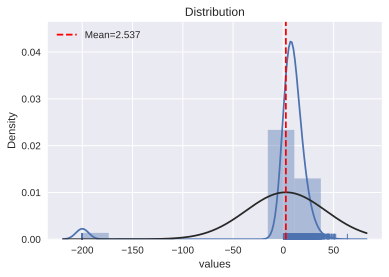

In [86]:
draw_histogram(data[TARGET]) 

**Log transformation**

In [87]:
draw_lognorm(data[TARGET])

Output hidden; open in https://colab.research.google.com to view.

* We see that the distribution seems to be more the normal one after lognorm transformation - it is more symmetrical now , domed, and  the variance turned out to be less. This is exactly what we assumed as the noise distribution.


**Testing normality**

In [88]:
shapiro_normality_testing(data[TARGET])

stat=0.333, p=0.000
Probably not Gaussian


**Conclusion**
* This distribution is not normal.
* Before doing linear model, target should be log transformed.


### **Numeric features**

**CO(GT)**

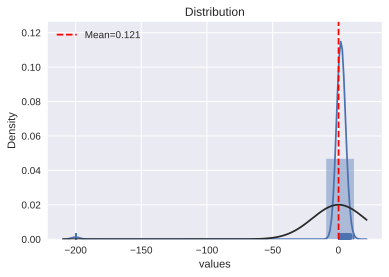

In [89]:
draw_histogram(data['CO(GT)'])

In [90]:
count_skewness_kurtosis(data['CO(GT)'])

Skewness: -9.908270
Kurtosis: 96.658558


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a long tail.
* Data looks like needed to be log transformed.

**Log transformation**

In [91]:
draw_lognorm(data['CO(GT)'])


Output hidden; open in https://colab.research.google.com to view.

**Testing normality**

In [92]:
shapiro_normality_testing(data['CO(GT)'])

stat=0.106, p=0.000
Probably not Gaussian


**Conclusion:**  

* I'd say it looks more like a log-normal distribution, so we can try to apply log transformation.
* After log transformation the distribution resembles a normal one, but the average values are slightly shifted to the right, while the distribution has a small left tail.

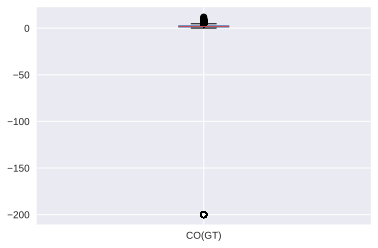

In [93]:
data.boxplot(column=['CO(GT)'])

**Conclusion** 
* This feature has some outlaiers, from near 0.
* The median is around 0.1.

**PT08.S1(CO)**

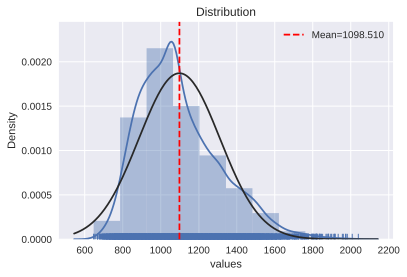

In [94]:
draw_histogram(data['PT08.S1(CO)'])

In [95]:
count_skewness_kurtosis(data['PT08.S1(CO)'])

Skewness: 0.787095
Kurtosis: 0.471594


* *Skewness* shows how symmetric the data is, from the value it is clear that the data is not strongly biased.
* *Kurtosis* shows that the distribution is not flattened and has a long tail.

**Testing normality**

In [96]:
shapiro_normality_testing(data['PT08.S1(CO)'])

stat=0.960, p=0.000
Probably not Gaussian


**Conclusion**:
* From about 1800 to 2200, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [97]:
data['PT08.S1(CO)'].describe()

count    9326.000000
mean     1098.510079
std       213.255277
min       647.000000
25%       941.000000
50%      1063.000000
75%      1222.000000
max      2040.000000
Name: PT08.S1(CO), dtype: float64

**Conclusion**

* For the *PT08.S1(CO)* attribute, it can be seen that the *MAX* value is 2040, while the *75% quartile* is 1200+.
The value 2040 is an *outlier*.
* Lets see at a *boxplot* to prove this.

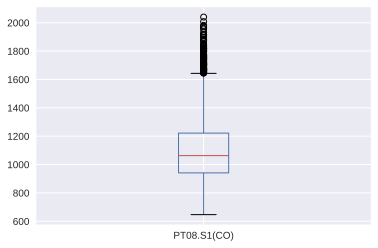

In [98]:
data.boxplot(column=['PT08.S1(CO)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 1700 to 2000+.
* The median is around 1100.


**PT08.S2(NMHC)**

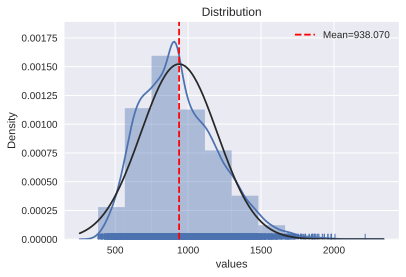

In [99]:
draw_histogram(data['PT08.S2(NMHC)'])

In [100]:
count_skewness_kurtosis(data['PT08.S2(NMHC)'])

Skewness: 0.583883
Kurtosis: 0.184036


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a right tail.

In [101]:
shapiro_normality_testing(data['PT08.S2(NMHC)'])

stat=0.977, p=0.000
Probably not Gaussian


**Conclusion:**

* From about 1600 to 2000+, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [102]:
data['PT08.S2(NMHC)'].describe()

count    9326.000000
mean      938.070234
std       262.054731
min       383.000000
25%       742.000000
50%       909.000000
75%      1106.000000
max      2214.000000
Name: PT08.S2(NMHC), dtype: float64

**Conclusion**

* For the *PT08.S2(NMHC)* attribute, it can be seen that the *MAX* value is 2000+, while the *75% quartile* is 1000+.
The value 2000+ is an *outlier*.
* Lets see at a *boxplot* to prove this.

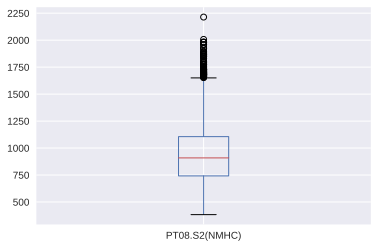

In [103]:
data.boxplot(column=['PT08.S2(NMHC)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 1750 to 2250.
* The median is around 940.


**NOx(GT)**

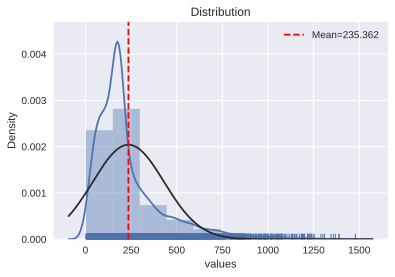

In [104]:
draw_histogram(data['NOx(GT)'])

**Log transformation**

In [105]:
draw_lognorm(data['NOx(GT)'])

Output hidden; open in https://colab.research.google.com to view.

In [106]:
count_skewness_kurtosis(data['NOx(GT)'])

Skewness: 2.009298
Kurtosis: 4.934986


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a right tail.


**Testing normality**

In [107]:
shapiro_normality_testing(data['NOx(GT)'])

stat=0.801, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 750 to 1500, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a left tail.

In [108]:
data['NOx(GT)'].describe()

count    9326.00000
mean      235.36232
std       195.38905
min         2.00000
25%       112.00000
50%       180.00000
75%       285.00000
max      1479.00000
Name: NOx(GT), dtype: float64

**Conclusion**
* For the *NOx(GT)* attribute, it can be seen that the *MAX* value is 1479, while the *75% quartile* is 285.
The value 1479 is an *outlier*.
* Lets see at a *boxplot* to prove this.

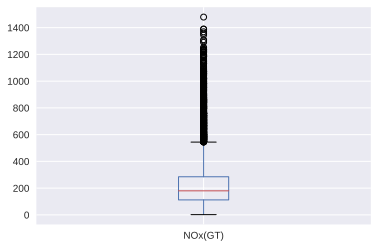

In [109]:
data.boxplot(column=['NOx(GT)'])

**Conclusion**
* This feature has many outlaiers around 600+.
* The median is around 235.

**PT08.S3(NOx)**

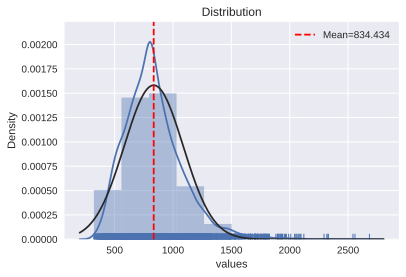

In [110]:
draw_histogram(data['PT08.S3(NOx)'])

In [111]:
count_skewness_kurtosis(data['PT08.S3(NOx)'])

Skewness: 1.133809
Kurtosis: 2.902439


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a long right tail.

**Testing normality**

In [112]:
shapiro_normality_testing(data['PT08.S3(NOx)'])

stat=0.944, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 1500 to 2500+, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [113]:
data['PT08.S3(NOx)'].describe()

count    9326.000000
mean      834.434163
std       252.221787
min       322.000000
25%       665.000000
50%       806.000000
75%       961.000000
max      2683.000000
Name: PT08.S3(NOx), dtype: float64

**Conclusion**
* For the *PT08.S3(NOx)* attribute, it can be seen that the *MAX* value is 2683, while the *75% quartile* is 969.
The value 2683 is an *outlier*.
* Lets see at a *boxplot* to prove this.

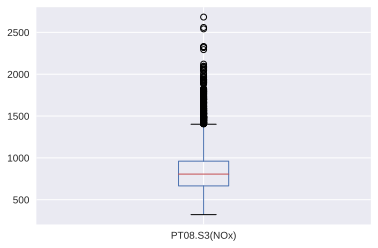

In [114]:
data.boxplot(column=['PT08.S3(NOx)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 1500+.
* The median is around 800.

**NO2(GT)**

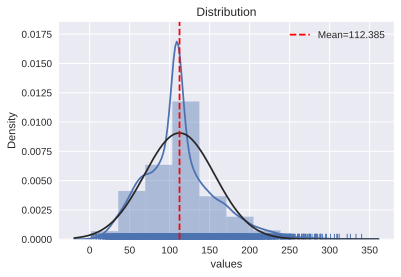

In [115]:
draw_histogram(data['NO2(GT)'])

In [116]:
count_skewness_kurtosis(data['NO2(GT)'])

Skewness: 0.730301
Kurtosis: 1.223602


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a right tail.


**Testing normality**

In [117]:
shapiro_normality_testing(data['NO2(GT)'])

stat=0.961, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 250 to 350, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [118]:
data['NO2(GT)'].describe()

count    9326.000000
mean      112.384516
std        44.021078
min         2.000000
25%        85.000000
50%       109.000000
75%       133.000000
max       340.000000
Name: NO2(GT), dtype: float64

**Conclusion**
* For the *NO2(GT)* attribute, it can be seen that the *MAX* value is 333, while the *75% quartile* is 132.
The value 333 is an *outlier*.
* Lets see at a *boxplot* to prove this.

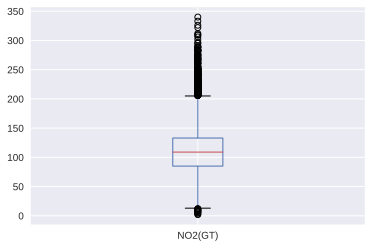

In [119]:
data.boxplot(column=['NO2(GT)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 200 to 300+ and around 0 to 30.
* The median is around 111.

**PT08.S4(NO2)**

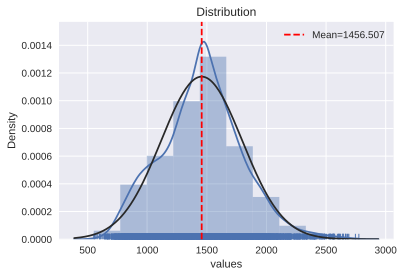

In [120]:
draw_histogram(data['PT08.S4(NO2)'])

In [121]:
count_skewness_kurtosis(data['PT08.S4(NO2)'])

Skewness: 0.207039
Kurtosis: 0.192034


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a small right tail.


**Testing normality**

In [122]:
shapiro_normality_testing(data['PT08.S4(NO2)'])

stat=0.993, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 2500 to 3000, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a small right tail.

In [123]:
data['PT08.S4(NO2)'].describe()

count    9326.000000
mean     1456.506541
std       339.933498
min       551.000000
25%      1241.000000
50%      1463.000000
75%      1662.750000
max      2775.000000
Name: PT08.S4(NO2), dtype: float64

**Conclusion**
* For the *PT08.S4(NO2)* attribute, it can be seen that the *MAX* value is 2775, while the *75% quartile* is 1600+.
The value 2775 is an *outlier*.
* Lets see at a *boxplot* to prove this.

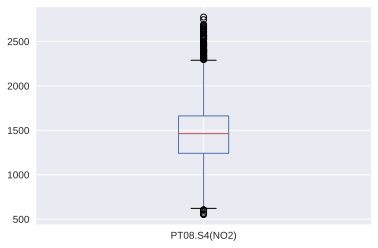

In [124]:
data.boxplot(column=['PT08.S4(NO2)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 2400+ and near 500.
* The median is around 1400.


**PT08.S5(O3)**

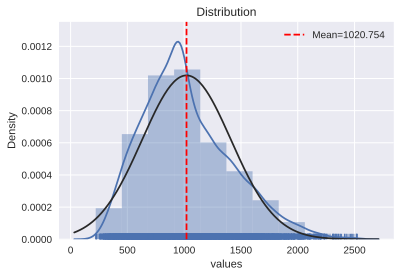

In [125]:
draw_histogram(data['PT08.S5(O3)'])

In [126]:
count_skewness_kurtosis(data['PT08.S5(O3)'])

Skewness: 0.655041
Kurtosis: 0.202398


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a small right tail.


**Testing normality**

In [127]:
shapiro_normality_testing(data['PT08.S5(O3)'])

stat=0.970, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 2500+ we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [128]:
data['PT08.S5(O3)'].describe()

count    9326.000000
mean     1020.754235
std       391.419866
min       221.000000
25%       741.000000
50%       963.000000
75%      1257.000000
max      2523.000000
Name: PT08.S5(O3), dtype: float64

**Conclusion**
* For the *PT08.S5(O3)* attribute, it can be seen that the *MAX* value is 2523, while the *75% quartile* is 1273.
The value 2523 is an *outlier*.
* Lets see at a *boxplot* to prove this.

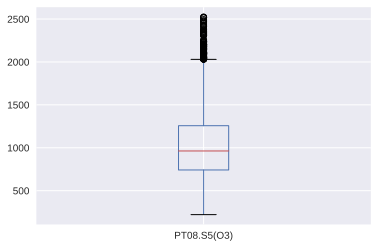

In [129]:
data.boxplot(column=['PT08.S5(O3)'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 2000 to 2550.
* The median is around 1000.

**T**

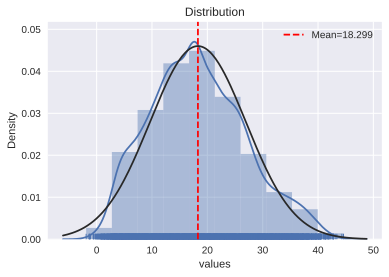

In [130]:
draw_histogram(data['T'])

In [131]:
count_skewness_kurtosis(data['T'])

Skewness: 0.321435
Kurtosis: -0.359395


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all.


**Testing normality**

In [132]:
shapiro_normality_testing(data['T'])

stat=0.987, p=0.000
Probably not Gaussian


**Conclusion:**
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.


In [133]:
data['T'].describe()

count    9326.000000
mean       18.299228
std         8.672554
min        -1.900000
25%        12.000000
50%        17.800000
75%        24.100000
max        44.600000
Name: T, dtype: float64

**Conclusion**
* For the *T* attribute, it can be seen that the *MAX* value is 44, while the *75% quartile* is 24.
The value 44 is an *outlier*.
* Lets see at a *boxplot* to prove this.

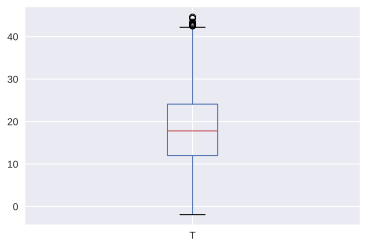

In [134]:
data.boxplot(column=['T'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 45 to 47.
* The median is around 18.

**RH**

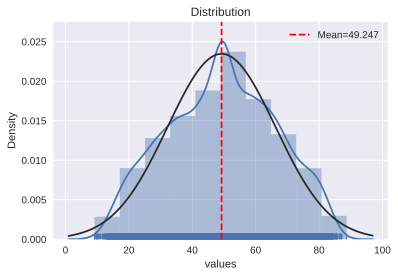

In [135]:
draw_histogram(data['RH'])

In [136]:
count_skewness_kurtosis(data['RH'])

Skewness: -0.040945
Kurtosis: -0.737010


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all.

**Testing normality**

In [137]:
shapiro_normality_testing(data['RH'])

stat=0.987, p=0.000
Probably not Gaussian


**Conclusion:**
* Looking at destribution it is heard to say about outliers.
* The distribution resembles to be not a normal one.

In [138]:
data['RH'].describe()

count    9326.000000
mean       49.247341
std        17.003130
min         9.200000
25%        36.500000
50%        49.600000
75%        61.900000
max        88.700000
Name: RH, dtype: float64

**Conclusion**
* For the *RH* attribute, it can be seen that the *MAX* value is 88, while the *75% quartile* is 62.
The value 88 is an *outlier*.
* Lets see at a *boxplot* to prove this.

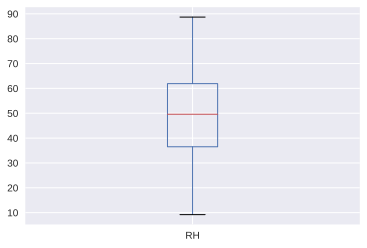

In [139]:
data.boxplot(column=['RH'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* The median is around 49.

**AH**

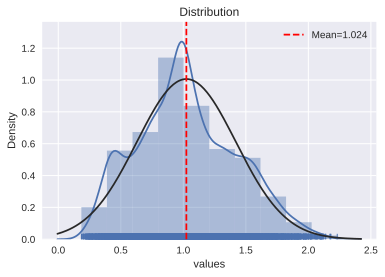

In [140]:
draw_histogram(data['AH'])

In [141]:
count_skewness_kurtosis(data['AH'])

Skewness: 0.264124
Kurtosis: -0.467337


* *Skewness* shows how symmetrical the data is, from the value it is clear that the data is not highly offset.
* *Kurtosis* shows that the distribution is not strongly flattened at all, but definitely has a small right tail.


**Testing normality**

In [142]:
shapiro_normality_testing(data['AH'])

stat=0.986, p=0.000
Probably not Gaussian


**Conclusion:**
* From about 2.3+, we can observe outliers.
* The distribution resembles to be not a normal one, but the average values are slightly shifted to the left, while the distribution has a right tail.

In [143]:
data['AH'].describe()

count    9326.000000
mean        1.024448
std         0.396532
min         0.184700
25%         0.745500
50%         0.995400
75%         1.298625
max         2.231000
Name: AH, dtype: float64

**Conclusion**
* For the *AH* attribute, it can be seen that the *MAX* value is 2, while the *75% quartile* is 1.
The value 2 is an *outlier*.
* Lets see at a *boxplot* to prove this.

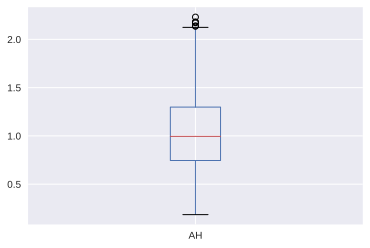

In [144]:
data.boxplot(column=['AH'])

**Conclusion**
* Later I should use StandartScaler in pipline.
* This feature has many outlaiers, from about 2.5.
* The median is around 1.

### **Distributions of categorical features**

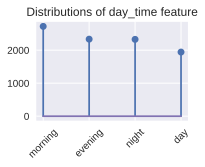

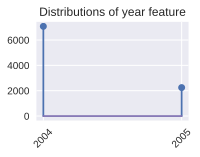

In [145]:
plot_cat_features('day_time', 'year')

**Conclusion**  
* The "day_time" feature has the most observations at "morning" time (6:00-12:00).
* The "year" attribute has the most observations in "2004".

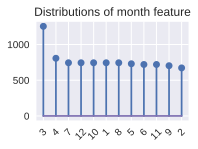

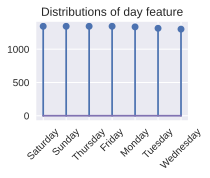

In [146]:
plot_cat_features('month', 'day')

**Conclusion**
* The "month" attribute has the most observations in the "3" month (March).
* The "day" attribute has practicaly the same distribution for each day.

### **Multivariate analysis**
Analysis of variables I thought which are important.

**The relationship between TARGET and year**

In [147]:
data.groupby(['year'])['C6H6(GT)'].mean()

year
2004    4.769586
2005   -4.497864
Name: C6H6(GT), dtype: float64

Text(0.5, 1.0, 'average of C6H6(GT) by year')

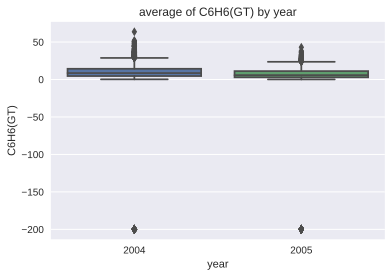

In [148]:
ax = sns.boxplot(x='year',y='C6H6(GT)', data=data)
ax.set_title('average of C6H6(GT) by year')

In [149]:
ym_targ = data.groupby(['year', 'month']).agg({TARGET:np.mean})
ym_targ

C6H6(GT)
year month           
2004 3       9.932745
     4       2.499583
     5      10.219041
     6      -0.519028
     7      10.316398
     8      -6.638978
     9      11.253627
     10     13.238306
     11     12.511806
     12    -13.027957
2005 1      -8.113172
     2     -15.966518
     3       8.449194
     4       4.285057

* **!** We need to collect and analyze more data from the previous marketing campaign to make sure that these phenomena are cyclical over time and can be trusted.
* So, that is why,  the years 2004-2005 have a different distribution of months and do not carry important information for further training of the model, so **it is worth removing this feature in the future.**


**The relationship between TARGET and day_time**

In [150]:
data.groupby(['day_time'])['C6H6(GT)'].mean()

day_time
day        3.272362
evening    4.001414
morning    4.811099
night     -2.204167
Name: C6H6(GT), dtype: float64

Text(0.5, 1.0, 'average of C6H6(GT) by day_time')

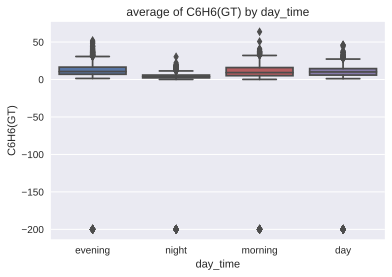

In [151]:
ax = sns.boxplot(x='day_time',y='C6H6(GT)', data=data)
ax.set_title('average of C6H6(GT) by day_time')

**Conclusion**
* It can be noted that between 6:00-12:00 (morning) there were peaks in the measurements of the true hourly average concentration of benzene in micrograms/m3.
* The largest average value can be observed in the morning, day and evening.
* The smallest average is observed at night.
* **!** We need to collect and analyze more data from the previous marketing campaign to make sure that these phenomena are cyclical over time and can be trusted.

**The relationship between TARGET and month**

Text(0.5, 1.0, 'average of C6H6(GT) by month')

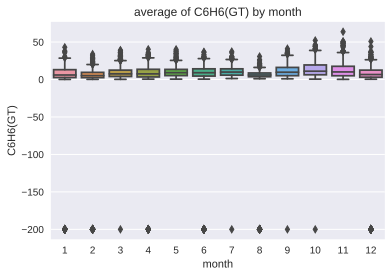

In [152]:
ax = sns.boxplot(x='month',y='C6H6(GT)', data=data)
ax.set_title('average of C6H6(GT) by month')

In [153]:
data.groupby(['month'])['C6H6(GT)'].sum()

month
1     -6036.2
2    -10729.5
3     11351.9
4      2172.5
5      7459.9
6      -373.7
7      7675.4
8     -4939.4
9      7911.3
10     9849.3
11     9008.5
12    -9692.8
Name: C6H6(GT), dtype: float64

**Conclusion**
* In October, November (10-11 months), there were the largest indicators of the substance.
* In February (2 month), the lowest indicators were the concentration of benzene in micrograms / m3.
* The largest average value can be observed in the 10th month(October).
* The smallest average is observed in the 8th month (August).
* **!** We need to collect and analyze more data from the previous marketing campaign to make sure that these phenomena are cyclical over time and can be trusted.


**The relationship between TARGET and day**

In [154]:
data.groupby(['day'])['C6H6(GT)'].sum()

day
Friday      -5831.6
Monday       6572.2
Saturday     8097.5
Sunday       2569.0
Thursday      685.0
Tuesday      7303.7
Wednesday    4261.4
Name: C6H6(GT), dtype: float64

Text(0.5, 1.0, 'average of C6H6(GT) by day of week')

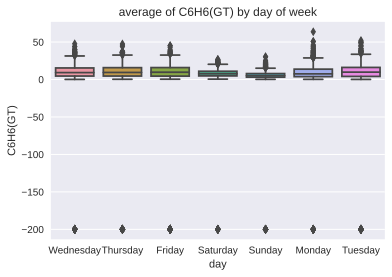

In [155]:
ax = sns.boxplot(x='day',y='C6H6(GT)', data=data)
ax.set_title('average of C6H6(GT) by day of week')

**Conclusion**
* On Sundays, there was a lower concentration of benzene in the air, perhaps this is justified by the weekend, and less activity at factories, for example.
* The highest concentration of benzene in the air was observed from Tuesday to Thursday-working days.
* The largest average value can be observed from Tuesday to Fridays.
* The smallest average is observed on Sundays.

In [156]:
print('average of C6H6(GT) by day & day_time')
print(data.groupby(['day', 'day_time'])['C6H6(GT)'].mean())

average of C6H6(GT) by day & day_time
day        day_time
Friday     day         -2.620714
           evening     -2.824702
           morning     -2.193112
           night       -9.788690
Monday     day          6.236823
           evening      7.922424
           morning      8.009694
           night       -2.707143
Saturday   day          5.736429
           evening      6.886012
           morning      8.768367
           night        2.203571
Sunday     day          1.996071
           evening      2.827976
           morning      0.924235
           night        2.076190
Thursday   day         -0.715714
           evening      3.404464
           morning      1.757653
           night       -2.819940
Tuesday    day          8.459273
           evening      2.824383
           morning     10.902597
           night       -0.409697
Wednesday  day          3.960886
           evening      6.997321
           morning      5.651330
           night       -4.050314
Name: C6H6(GT), dt

In [157]:
print('average of C6H6(GT) by month & day_time')
print(data.groupby(['month', 'day_time'])['C6H6(GT)'].mean())

average of C6H6(GT) by month & day_time
month  day_time
1      day         -3.677419
       evening    -11.759677
       morning     -4.729493
       night      -12.110753
2      day        -16.456429
       evening    -16.017857
       morning    -14.208163
       night      -17.558333
3      day          9.699231
       evening     13.136164
       morning      9.645055
       night        3.660256
4      day          1.149701
       evening      6.012626
       morning      5.434874
       night       -2.468137
5      day         11.229032
       evening     12.398343
       morning     12.398131
       night        4.567222
6      day         -1.338000
       evening     -0.677778
       morning      5.493810
       night       -6.692778
7      day         10.083226
       evening     13.271505
       morning     12.894931
       night        4.547312
8      day         -9.707097
       evening     -7.537097
       morning     -4.429032
       night       -5.762366
9      day      

* The highest concentrations of benzene in the air are observed in the evening on all days and any months.

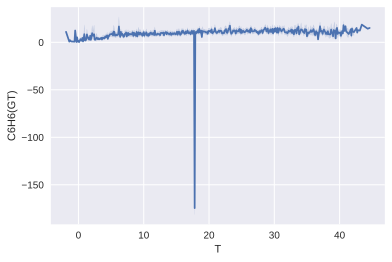

In [158]:
sns.lineplot(data=data, x="T", y="C6H6(GT)")

* A slight increase in benzene indicators in the air is visible from 10 to 35 degrees
* At 42+ degrees, the indicators also grow.
* The lowest values of benzene at 0 degrees.
* Guess, that it's an outlier near 20 degrees.

### **Correlation**

* Evaluation of the pairwise dependencies of numerical features.
* Calculation and visualization of the correlation matrix.

In [159]:
corr_features = NUMERICAL.copy()
corr_features.append('C6H6(GT)')
corr_features

['CO(GT)',
 'PT08.S1(CO)',
 'PT08.S2(NMHC)',
 'NOx(GT)',
 'PT08.S3(NOx)',
 'NO2(GT)',
 'PT08.S4(NO2)',
 'PT08.S5(O3)',
 'T',
 'RH',
 'AH',
 'C6H6(GT)']

In [160]:
num_data = data.loc[:,corr_features]
corr_matrix = num_data.corr(method='spearman').round(4)
corr_matrix

,CO(GT),PT08.S1(CO),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,C6H6(GT)
CO(GT),1.0000,0.7702,0.8196,0.7044,-0.7123,0.6685,0.5428,0.7578,0.0835,-0.0191,0.0596,0.7538
PT08.S1(CO),0.7702,1.0000,0.8877,0.6163,-0.8526,0.5790,0.6422,0.8934,0.0806,0.0914,0.1352,0.8411
PT08.S2(NMHC),0.8196,0.8877,1.0000,0.5966,-0.8475,0.5764,0.7457,0.8714,0.2757,-0.1240,0.1890,0.9461
NOx(GT),0.7044,0.6163,0.5966,1.0000,-0.6832,0.8148,0.1241,0.6880,-0.2557,0.1648,-0.1647,0.5478
PT08.S3(NOx),-0.7123,-0.8526,-0.8475,-0.6832,1.0000,-0.5984,-0.5326,-0.8606,-0.1189,-0.0829,-0.2164,-0.8038
NO2(GT),0.6685,0.5790,0.5764,0.8148,-0.5984,1.0000,0.1319,0.6168,-0.1632,-0.1089,-0.2801,0.5260
PT08.S4(NO2),0.5428,0.6422,0.7457,0.1241,-0.5326,0.1319,1.0000,0.5566,0.6140,-0.0681,0.6411,0.7069
PT08.S5(O3),0.7578,0.8934,0.8714,0.6880,-0.8606,0.6168,0.5566,1.0000,-0.0019,0.1271,0.0804,0.8261
T,0.0835,0.0806,0.2757,-0.2557,-0.1189,-0.1632,0.6140,-0.0019,1.0000,-0.5394,0.7014,0.2600
RH,-0.0191,0.0914,-0.1240,0.1648,-0.0829,-0.1089,-0.0681,0.1271,-0.5394,1.0000,0.1524,-0.1151


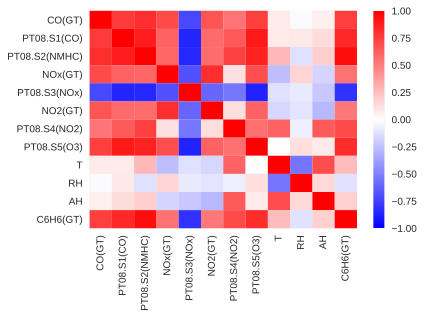

In [161]:
sns.heatmap(corr_matrix, vmin=-1, vmax=1, cmap='bwr')

**Conclusion**  
* It is important to understand that if the variables are strongly related to each other, then this can affect the training of the model in a bad way. The model will not adequately, in particular the linear model, calculate the weights and parameters of the model.

* At first glance, it is possible to distinguish a pair of red squares, the greatest dependence is observed between these features. **'CO(GT)', 'PT08.S1(CO)', 'C6H6(GT)', 'PT08.S2(NMHC)', 'NOx(GT)', 'PT08.S3(NOx)'(srtong negative corr), 'NO2(GT)', 'PT08.S4(NO2)', 'PT08.S5(O3)'**

* Target variable also highly correlated with practically all features, except 'RH'.
* The correlation between these features is extremely strong, which may indicate a situation of multicollinearity.

* It can be concluded that they give almost the same information, so multicollinearity really takes place.

### **Correlation coefficients**

See multicollinearity between some features:

**'PT08.S1(CO)' & 'PT08.S2(NMHC)'**

In [162]:
np.corrcoef(data['PT08.S1(CO)'], data['PT08.S2(NMHC)'])

array([[1.        , 0.89298663],
       [0.89298663, 1.        ]])

* This correlation is 0.89, a strong positive correlation, let’s take a look at a scatter chart.

In [163]:
sns.pairplot(data.loc[:, ['PT08.S1(CO)', 'PT08.S2(NMHC)']])

Output hidden; open in https://colab.research.google.com to view.

* Can observe some outliers.

**NOx(GT) & NO2(GT)**

In [164]:
np.corrcoef(data['NOx(GT)'], data['NO2(GT)'])

array([[1.        , 0.76075219],
       [0.76075219, 1.        ]])

* This correlation is 0.76, a positive correlation, let’s take a look at a scatter chart.

In [165]:
sns.pairplot(data.loc[:, ['NOx(GT)', 'NO2(GT)']])

Output hidden; open in https://colab.research.google.com to view.

**'PT08.S1(CO)' & 'PT08.S5(O3)'**

In [166]:
  np.corrcoef(data['PT08.S1(CO)'], data['PT08.S5(O3)'])

array([[1.        , 0.89940966],
       [0.89940966, 1.        ]])

* This correlation is 0.899, a strong positive correlation, let’s take a look at a scatter chart.

In [167]:
sns.pairplot(data.loc[:, ['PT08.S1(CO)', 'PT08.S5(O3)']])

Output hidden; open in https://colab.research.google.com to view.

**Conclusion**  
* There are srting correlations between features, hence conclude the presence of multicollinearity in the data.

See spearman r coeff between target & some features:

**Target & PT08.S1(CO)**

In [168]:
stats.spearmanr(data['C6H6(GT)'], data['PT08.S1(CO)'])

SpearmanrResult(correlation=0.8411356336188819, pvalue=0.0)

This correlation is 0.84, a strong positive correlation.

**Target & PT08.S2(NMHC)**

In [169]:
stats.spearmanr(data['C6H6(GT)'], data['PT08.S2(NMHC)'])

SpearmanrResult(correlation=0.9461491561634096, pvalue=0.0)

This correlation is practically 0.95, a positive correlation.

**Target & NOx(GT)**

In [170]:
stats.spearmanr(data['C6H6(GT)'], data['NOx(GT)'])

SpearmanrResult(correlation=0.5478462371598455, pvalue=0.0)

This correlation is 0.5. It's not a very strong positive correlation.

**Target & NO2(GT)**

In [171]:
stats.spearmanr(data['C6H6(GT)'], data['NO2(GT)'])

SpearmanrResult(correlation=0.526041029355615, pvalue=0.0)

This correlation is 0.53. It's not a very strong positive correlation.

**Target & PT08.S4(NO2)**

In [172]:
stats.spearmanr(data['C6H6(GT)'], data['PT08.S4(NO2)'])

SpearmanrResult(correlation=0.7069396220904087, pvalue=0.0)

This correlation is 0.7, a strong positive correlation.

**Conclusion**  
* The highest correlation with target have *'PT08.S2(NMHC)', 'PT08.S1(CO)'* and *'PT08.S4(NO2)'* features.
* From the above correlation heatmap, we can observe that the variables: 'PT08.S2(NMHC)', 'PT08.S1(CO)', 'PT08.S4(NO2)' and TARGET are highly correlated (searman coefficient> 0.7) with each other.

# **Transformation**

### **Encoding**

In [173]:
# dropping wos proved ealier
data.drop(['year'],
           axis=1, inplace=True)
data.head(3)

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,month,day,day_time
0,2.6,1360.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578,3,Wednesday,evening
1,2.0,1292.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255,3,Wednesday,evening
2,2.2,1402.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502,3,Wednesday,evening


In [174]:
ct = ColumnTransformer(
    [
        ('day_time', OneHotEncoder(sparse=False, categories='auto'), ['day_time']), 
        ('month', OneHotEncoder(sparse=False), ['month']), 
        ('day', OneHotEncoder(sparse=False), ['day'])
    ],
    remainder='drop'
)
ct.fit(data)

ColumnTransformer(n_jobs=None, remainder='drop', sparse_threshold=0.3,
                  transformer_weights=None,
                  transformers=[('day_time',
                                 OneHotEncoder(categories='auto', drop=None,
                                               dtype=<class 'numpy.float64'>,
                                               handle_unknown='error',
                                               sparse=False),
                                 ['day_time']),
                                ('month',
                                 OneHotEncoder(categories='auto', drop=None,
                                               dtype=<class 'numpy.float64'>,
                                               handle_unknown='error',
                                               sparse=False),
                                 ['month']),
                                ('day',
                                 OneHotEncoder(categories='auto', drop=None,
            

In [175]:
ct.get_feature_names()

['day_time__x0_day',
 'day_time__x0_evening',
 'day_time__x0_morning',
 'day_time__x0_night',
 'month__x0_1',
 'month__x0_2',
 'month__x0_3',
 'month__x0_4',
 'month__x0_5',
 'month__x0_6',
 'month__x0_7',
 'month__x0_8',
 'month__x0_9',
 'month__x0_10',
 'month__x0_11',
 'month__x0_12',
 'day__x0_Friday',
 'day__x0_Monday',
 'day__x0_Saturday',
 'day__x0_Sunday',
 'day__x0_Thursday',
 'day__x0_Tuesday',
 'day__x0_Wednesday']

In [176]:
X = pd.DataFrame(ct.transform(data),
                 columns=[x.replace('__x0', '') for x in ct.get_feature_names()], index=data.index)
X.head(10)

,day_time_day,day_time_evening,day_time_morning,day_time_night,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12,day_Friday,day_Monday,day_Saturday,day_Sunday,day_Thursday,day_Tuesday,day_Wednesday
0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
1,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
3,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
4,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
5,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
6,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
7,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
8,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
9,0.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0


In [177]:
data = data.join(X)

data.tail(5)

,CO(GT),PT08.S1(CO),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH,month,day,day_time,day_time_day,day_time_evening,day_time_morning,day_time_night,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12,day_Friday,day_Monday,day_Saturday,day_Sunday,day_Thursday,day_Tuesday,day_Wednesday
9352,3.1,1314.0,13.5,1101.0,472.0,539.0,190.0,1374.0,1729.0,21.9,29.3,0.7568,4,Monday,morning,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
9353,2.4,1163.0,11.4,1027.0,353.0,604.0,179.0,1264.0,1269.0,24.3,23.7,0.7119,4,Monday,morning,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
9354,2.4,1142.0,12.4,1063.0,293.0,603.0,175.0,1241.0,1092.0,26.9,18.3,0.6406,4,Monday,morning,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
9355,2.1,1003.0,9.5,961.0,235.0,702.0,156.0,1041.0,770.0,28.3,13.5,0.5139,4,Monday,day,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0
9356,2.2,1071.0,11.9,1047.0,265.0,654.0,168.0,1129.0,816.0,28.5,13.1,0.5028,4,Monday,day,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0


In [178]:
data.drop(['day_time', 'month', 'day'],
           axis=1, inplace=True)

In [179]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9326 entries, 0 to 9356
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   CO(GT)            9326 non-null   float64
 1   PT08.S1(CO)       9326 non-null   float64
 2   C6H6(GT)          9326 non-null   float64
 3   PT08.S2(NMHC)     9326 non-null   float64
 4   NOx(GT)           9326 non-null   float64
 5   PT08.S3(NOx)      9326 non-null   float64
 6   NO2(GT)           9326 non-null   float64
 7   PT08.S4(NO2)      9326 non-null   float64
 8   PT08.S5(O3)       9326 non-null   float64
 9   T                 9326 non-null   float64
 10  RH                9326 non-null   float64
 11  AH                9326 non-null   float64
 12  day_time_day      9326 non-null   float64
 13  day_time_evening  9326 non-null   float64
 14  day_time_morning  9326 non-null   float64
 15  day_time_night    9326 non-null   float64
 16  month_1           9326 non-null   float64


### **Log transformation**  




In EDA part I note that features *'CO(GT), 'NOx(GT)' and TARGET* should be log transformed.

In [180]:
data['CO(GT)'] = np.log(data['CO(GT)'])
data['NOx(GT)'] = np.log(data['NOx(GT)'])
data[TARGET] = np.log(data[TARGET])

In [181]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 9326 entries, 0 to 9356
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   CO(GT)            9235 non-null   float64
 1   PT08.S1(CO)       9326 non-null   float64
 2   C6H6(GT)          8991 non-null   float64
 3   PT08.S2(NMHC)     9326 non-null   float64
 4   NOx(GT)           9326 non-null   float64
 5   PT08.S3(NOx)      9326 non-null   float64
 6   NO2(GT)           9326 non-null   float64
 7   PT08.S4(NO2)      9326 non-null   float64
 8   PT08.S5(O3)       9326 non-null   float64
 9   T                 9326 non-null   float64
 10  RH                9326 non-null   float64
 11  AH                9326 non-null   float64
 12  day_time_day      9326 non-null   float64
 13  day_time_evening  9326 non-null   float64
 14  day_time_morning  9326 non-null   float64
 15  day_time_night    9326 non-null   float64
 16  month_1           9326 non-null   float64


In [182]:
data.dropna(subset = [TARGET], inplace=True)

In [183]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8991 entries, 0 to 9356
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   CO(GT)            8901 non-null   float64
 1   PT08.S1(CO)       8991 non-null   float64
 2   C6H6(GT)          8991 non-null   float64
 3   PT08.S2(NMHC)     8991 non-null   float64
 4   NOx(GT)           8991 non-null   float64
 5   PT08.S3(NOx)      8991 non-null   float64
 6   NO2(GT)           8991 non-null   float64
 7   PT08.S4(NO2)      8991 non-null   float64
 8   PT08.S5(O3)       8991 non-null   float64
 9   T                 8991 non-null   float64
 10  RH                8991 non-null   float64
 11  AH                8991 non-null   float64
 12  day_time_day      8991 non-null   float64
 13  day_time_evening  8991 non-null   float64
 14  day_time_morning  8991 non-null   float64
 15  day_time_night    8991 non-null   float64
 16  month_1           8991 non-null   float64


In [184]:
for сolumn in ['CO(GT)']:
    avarage = data.loc[:, сolumn].median(skipna = True)
    data.loc[:, сolumn].fillna(avarage, inplace=True)
    print(f"{сolumn}: average value --> {avarage}") 

CO(GT): average value --> 0.5877866649021191


In [185]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8991 entries, 0 to 9356
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   CO(GT)            8991 non-null   float64
 1   PT08.S1(CO)       8991 non-null   float64
 2   C6H6(GT)          8991 non-null   float64
 3   PT08.S2(NMHC)     8991 non-null   float64
 4   NOx(GT)           8991 non-null   float64
 5   PT08.S3(NOx)      8991 non-null   float64
 6   NO2(GT)           8991 non-null   float64
 7   PT08.S4(NO2)      8991 non-null   float64
 8   PT08.S5(O3)       8991 non-null   float64
 9   T                 8991 non-null   float64
 10  RH                8991 non-null   float64
 11  AH                8991 non-null   float64
 12  day_time_day      8991 non-null   float64
 13  day_time_evening  8991 non-null   float64
 14  day_time_morning  8991 non-null   float64
 15  day_time_night    8991 non-null   float64
 16  month_1           8991 non-null   float64


### **Box-Cox**
* I also tried to use box-cox data transformation to avoid heteroscedasticity in the data, as one of the techniques, but the *Breush-Pagan* and *Goldfeld Quandt* tests showed that heteroscedasticity is preserved even when using this technique.
* In conclusion, I will describe the techniques that you can also try to use to improve the model and confirm the reliability of the results.



In [186]:
# from scipy.special import boxcox1p
# cols = ['PT08.S1(CO)', 'PT08.S2(NMHC)', 'PT08.S3(NOx)', 'NO2(GT)','PT08.S4(NO2)', 'PT08.S5(O3)', 'T', 'RH', 'AH', 'CO(GT)', TARGET,'NOx(GT)' ]
# for column in cols:
#   data[column] = boxcox1p(data[column],0.25)

### **Standartisation**

Since we work with distances between objects, heterogeneity in the values of features can greatly distort the results of the analysis. Thus, a feature that itself takes high values can be decisive when calculating distances, while features with low values may have almost no effect.

To solve this problem, I STANDARDIZE the data before analyzing it.

In [187]:
std_scaler = StandardScaler()
df = pd.DataFrame(std_scaler.fit_transform(data), columns=data.columns, index=data.index)

### **PCA**  
* PCA solves the issue of eigenvectors/values. We apply PCA to remove colinearity during the training phase of linear regression and neural networks. PCA resembles a low-dimensional representation of the observations that explains a good fraction of the variance .
* We can use PCA to reduce the number of variables, avoid multicollinearity, or have too many predictors relative to the number of observations. PCA is a linear combination of the p features, and taking these linear combinations of the measurements is essential to reduce the number of plots necessary for visual analysis while retaining most of the information present in the data.
* Feature reduction is an essential preprocessing step in machine learning. Therefore, PCA is an essential step of preprocessing and very useful for compression and noise removal in the data. It reduces the dimensionality of a dataset by finding a new set of variables smaller than the original set of variables.


* We do not need it for dimesionality reduction of course, as our model is not that complex, We need to remove the multicollinearity problem in our data.

* We are going to feed in our standardized predictor variables into the the PCA transformation and get a set of uncorrelated features.

In [188]:
from sklearn.decomposition import PCA

cols = ['PCA' + str(i) for i in range(1,35)]
pca = PCA(n_components=34)
X = df.drop(TARGET,axis=1)
X_pca = pca.fit_transform(X)
df_std_pca = pd.DataFrame(X_pca,columns=cols, index=df.index)
df_std_pca[TARGET] = df[TARGET]

* Lets look at the correlation matrix now.

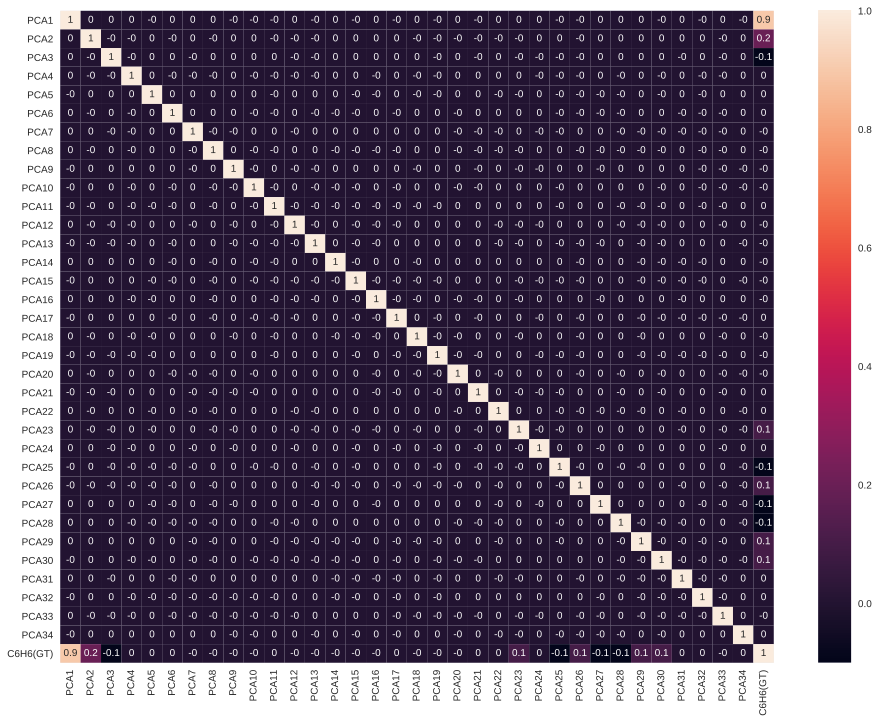

In [189]:
fig = plt.figure(figsize=(16,12))
ax = fig.add_subplot(111)
sns.heatmap(df_std_pca.corr().round(1),annot=True)

* As you can see there is no correlation between predictor variables, thus removing multicollinearity.
* The reason correlation between predictor variable and target varaiable is in sorted order is because, PCA takes all the explained variation and puts it into first components, and repeats the process. The new feature are in no way related to the old ones, therfore it would be wrong to use the same name for them.
* PCA is often used to make the data Anonymous as it makes the data completely different from the original one, while still keeping the information in the data intact.

**Distribution of our features after applying PCA**

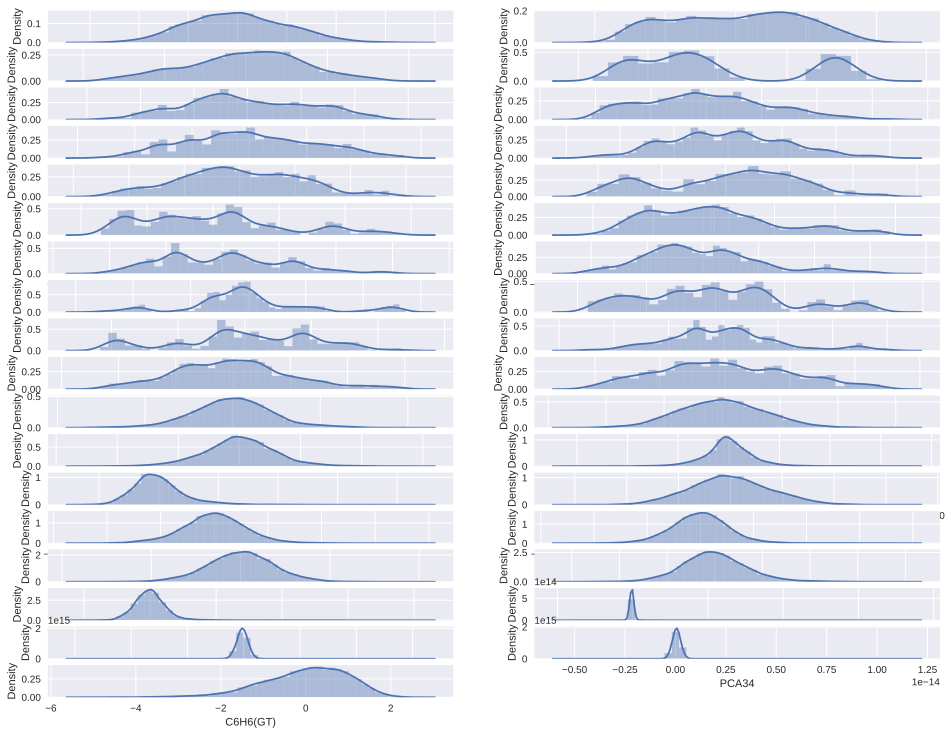

In [190]:
pos = 1
fig = plt.figure(figsize=(16,24))
for i in df_std_pca.columns:
    ax = fig.add_subplot(34,2,pos)
    pos = pos + 1
    sns.distplot(df_std_pca[i],ax=ax)

# **Split**

In [ ]:
from sklearn.model_selection import train_test_split

(trainData, 
 testData, 
 train_label, 
 test_label) = train_test_split(df_std_pca.drop(TARGET,
                                            axis=1),
                                            df_std_pca[TARGET],
                                            test_size=0.2,
                                            random_state=42)

print('Size of train set:', trainData.shape)
print('Size of test set:', testData.shape)

print('\nClass distribution on train:',
      train_label.value_counts(normalize=True),
      '\nClass distribution on test:', 
      test_label.value_counts(normalize=True),
      sep='\n')

Size of train set: (7192, 34)
Size of test set: (1799, 34)

Class distribution on train:
-1.174964    0.009733
-0.875036    0.009316
-0.749294    0.009177
-1.053493    0.009177
-1.310215    0.009038
               ...   
 1.772728    0.000139
 2.136613    0.000139
 2.131285    0.000139
 2.203794    0.000139
 2.007618    0.000139
Name: C6H6(GT), Length: 391, dtype: float64

Class distribution on test:
-1.576523    0.010561
-0.133703    0.010561
 0.032320    0.010561
-1.133085    0.009450
-0.369239    0.009450
               ...   
 1.547179    0.000556
 1.408788    0.000556
 1.647387    0.000556
 1.423372    0.000556
 2.162901    0.000556
Name: C6H6(GT), Length: 302, dtype: float64


* Make sure that the distribution of the target variable (C6H6(GT)) is the same in both parts.

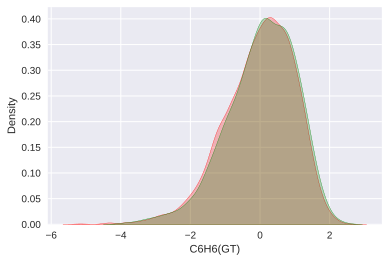

In [ ]:
fig = sns.kdeplot(train_label, shade=True, color="r")
fig = sns.kdeplot(test_label, shade=True, color="g")
plt.show()

# **Linear regression**

In [ ]:
from sklearn import linear_model
from sklearn import preprocessing
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV, cross_val_score
from sklearn.linear_model import LinearRegression

from sklearn import metrics
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import KFold

### **Simple model**

In [ ]:
%%time

regressionModel = linear_model.LinearRegression()
regressionModel.fit(trainData, train_label)

CPU times: user 14 ms, sys: 5.05 ms, total: 19.1 ms
Wall time: 23.1 ms


In [ ]:
predicted_dv = regressionModel.predict(testData)
predicted_dv

array([ 0.06718986,  2.11363788,  0.01408605, ...,  0.00695529,
        0.98824513, -1.41444128])

At first, estimate the distribution of the target variable on the graph.

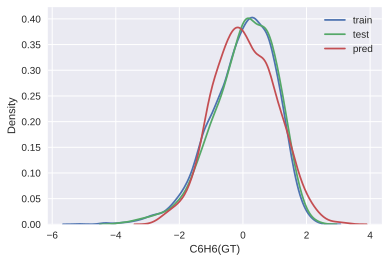

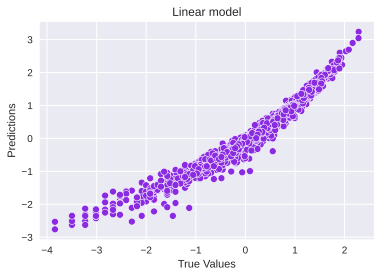

In [ ]:
target_distr_linear(train_label, test_label, predicted_dv)   

**Look at feature importance**

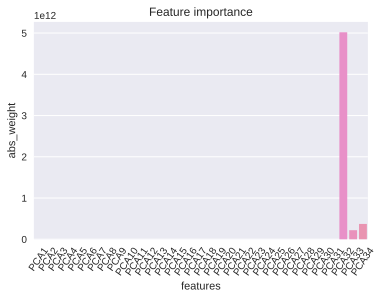

In [ ]:
get_feature_importance(model=regressionModel)

* Only a few features have a significant contribution.

### **Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


In [ ]:
errors = test_label - predicted_dv

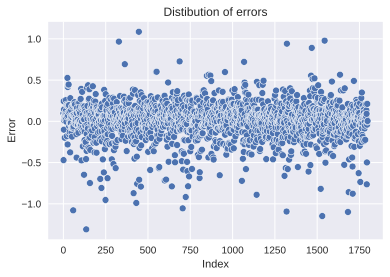

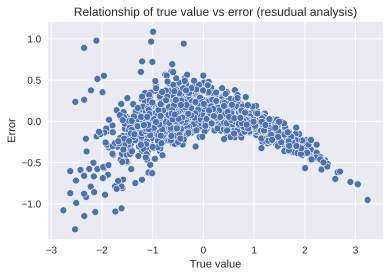

In [ ]:
draw_heteroscedasticity(errors, predicted_dv)

**Conclusion**
* The trend in the second figure is clearly visible, now we will confirm the presence of heteroskedasticity on tests.

**Now I will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.


**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testData)

[('F statistic', 0.8673255568533381), ('p-value', 0.9819538662457633)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.

**Breush-Pagan test:**

In [ ]:
test_breuschpagan(errors, testData)

[('Lagrange multiplier statistic', 513.9444149565295), ('p-value', 1.157073755384309e-87), ('f-value', 22.80944952558298), ('f p-value', 1.6652798372944639e-106)]


* The test is significant meaning the data violates the assumption of homoscedasticity, i.e. heteroscedasticity is present in the data. 



**The White Test**
* If  dataset has many explanatory variables, the test may be challenging to calculate (looking at correlation table after PCA, I can say, that we should't use this test. 


### **Metrics**

**Errors on the train**

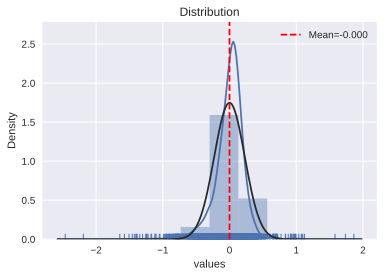

In [ ]:
error = train_label - regressionModel.predict(trainData)
draw_histogram(error)

* We see that the distribution is not similar to the normal one - it is a little bit assumetrical, but it has an average expectation of zero. This is exactly what we assumed as the noise distribution.

In [ ]:
calc_metrics(train_label, regressionModel.predict(trainData), regressionModel,trainData, train_label)

*** VAL **: 
MSE:   0.052057190214621324
RMSE:  0.22816044840116642
R2:    0.9483088889945943
MAE:   0.15711271119558995
MedAE: 0.11460228682571749
------------------------------
*** Average cross-validation scores ***:
MSE:   0.05734202629408314
RMSE:  0.2392529088419416
R2:    0.9429766658995005
MAE:   0.1663486289097199
MedAE: 0.12363105377650294
------------------------------


**Errors on the test**

In [ ]:
calc_metrics(test_label, predicted_dv, regressionModel, testData, test_label)

*** VAL **: 
MSE:   0.02759467725505013
RMSE:  0.166116456906142
R2:    0.9719944378968924
MAE:   0.12351695002898307
MedAE: 0.09657427852965772
------------------------------
*** Average cross-validation scores ***:
MSE:   0.02986702983273721
RMSE:  0.172644873964966
R2:    0.9695498259086284
MAE:   0.12807209543420747
MedAE: 0.09761485541439882
------------------------------


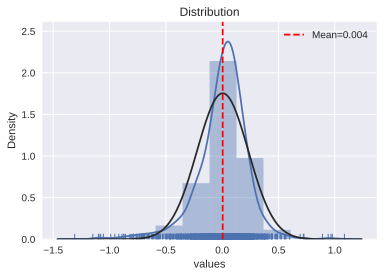

In [ ]:
error = test_label - predicted_dv
draw_histogram(error)

* It can be seen that the variance turned out to be larger on the test, but not much.

**Conclusion** 
* The errors are about the same as on the train, which means that the model has practically not been retrained. Everything is quite good at the moment. 
* R2 score is very close to 1 both on the train and on the test, the values are slightly worse on the test.

In [ ]:
regressionModel.intercept_

-0.002241205276577115

* When we train the model, we have an intercept that greatly distorts the results, in this case its value is extremely small.

### **Hyperparameters tuning**  
Selection of optimal hyperparameters for cross-validation

In [ ]:
params = [
    {
        'n_jobs': [i for i in range(-1, 50, 3)],
        'fit_intercept': [True, False],
        'normalize' : [True, False]
    }
]

In [ ]:
rf_model = linear_model.LinearRegression()

cv = KFold(n_splits=5, shuffle=True, random_state=42)
gs = GridSearchCV(rf_model, params, 
                  n_jobs=-1, 
                  scoring=['neg_mean_squared_error', 'r2'], 
                  refit='neg_mean_squared_error', 
                  cv=cv)

In [ ]:
%%time
gs.fit(trainData,train_label);

CPU times: user 643 ms, sys: 96.7 ms, total: 739 ms
Wall time: 4.33 s


GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             error_score=nan,
             estimator=LinearRegression(copy_X=True, fit_intercept=True,
                                        n_jobs=None, normalize=False),
             iid='deprecated', n_jobs=-1,
             param_grid=[{'fit_intercept': [True, False],
                          'n_jobs': [-1, 2, 5, 8, 11, 14, 17, 20, 23, 26, 29,
                                     32, 35, 38, 41, 44, 47],
                          'normalize': [True, False]}],
             pre_dispatch='2*n_jobs', refit='neg_mean_squared_error',
             return_train_score=False, scoring=['neg_mean_squared_error', 'r2'],
             verbose=0)

In [ ]:
gs.best_params_

{'fit_intercept': True, 'n_jobs': -1, 'normalize': True}

Now we will train the model with the selected parameters

In [ ]:
regressionModel = linear_model.LinearRegression(normalize=True,
                                                fit_intercept=True, n_jobs=-1)
regressionModel.fit(trainData, train_label)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=True)

In [ ]:
predictedDependentVariables = regressionModel.predict(testData)

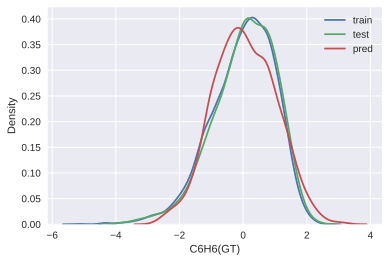

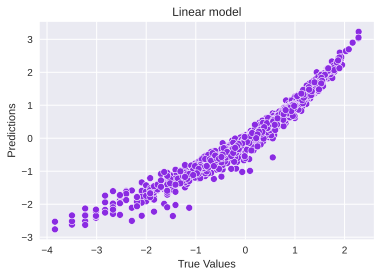

In [ ]:
target_distr_linear(train_label, test_label, predictedDependentVariables)   


**Look at feature importance**

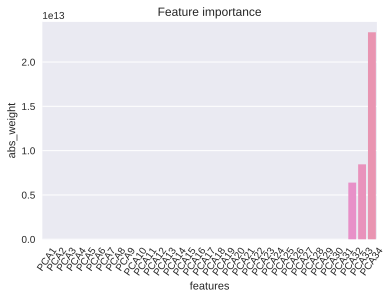

In [ ]:
get_feature_importance(regressionModel)

*  Only a few features have a significant contribution

* Three features(two of them to the greatest extent) play the greatest role in the problem of predictive modeling.






### **Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


In [ ]:
errors = test_label - predictedDependentVariables

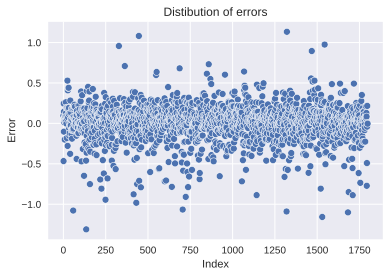

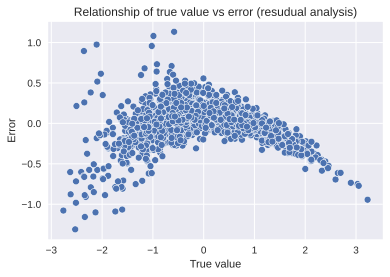

In [ ]:
draw_heteroscedasticity(errors, predictedDependentVariables)

**Conclusion**
* The trend in the second figure is clearly visible, now we will confirm the presence of heteroskedasticity on tests.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.


**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testData)

[('F statistic', 0.863435445628182), ('p-value', 0.9846915936729517)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.


**Breush-Pagan test:**

In [ ]:
test_breuschpagan(errors, testData)

[('Lagrange multiplier statistic', 510.959237625488), ('p-value', 4.704702391633244e-87), ('f-value', 22.624407512525703), ('f p-value', 1.1905725750206247e-105)]


* The test is significant meaning the data violates the assumption of homoscedasticity, i.e. heteroscedasticity is present in the data. 



### **Metrics**

**Errors on the train**

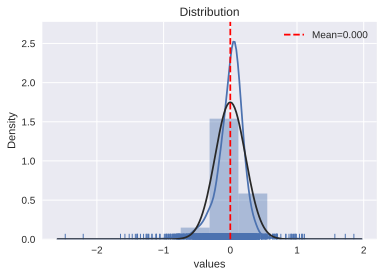

In [ ]:
error = train_label - regressionModel.predict(trainData)
draw_histogram(error)

In [ ]:
calc_metrics(train_label, regressionModel.predict(trainData), regressionModel, trainData, train_label)

*** VAL **: 
MSE:   0.05200311925275894
RMSE:  0.2280419243313802
R2:    0.9483625797159005
MAE:   0.15707400105226188
MedAE: 0.1146079975597789
------------------------------
*** Average cross-validation scores ***:
MSE:   0.05328713702653257
RMSE:  0.23081465812945554
R2:    0.9469564243048925
MAE:   0.15852415532391717
MedAE: 0.11562318576765793
------------------------------


**Errors on the test**

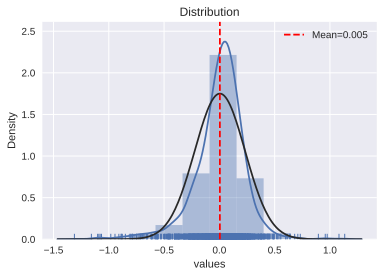

In [ ]:
error = test_label - predictedDependentVariables
draw_histogram(error)

In [ ]:
calc_metrics(test_label, predictedDependentVariables, regressionModel, testData, test_label)

*** VAL **: 
MSE:   0.051967108578227054
RMSE:  0.22796295439879494
R2:    0.946342374206749
MAE:   0.16074878278478294
MedAE: 0.11665142903637604
------------------------------
*** Average cross-validation scores ***:
MSE:   0.052758459415694625
RMSE:  0.22941001185650373
R2:    0.9453104726388908
MAE:   0.1591849854296098
MedAE: 0.11395640222468502
------------------------------


**Conclusion**

* On the test, R2 score fell slightly (it was *R2: 0.9420064807501489*, it became *R2: 0.9418757552354519*).
* Such a high estimate is partly due to heteroscedasticity, which should be excluded from the regression model. In the results, I will describe ways to exclude heteroscedasticity from the data.

# **Regularization**

## **Ridge regression**

### **Simple model**

In [ ]:
ridgeModel = linear_model.Ridge()

In [ ]:
ridgeModel.fit(trainData, train_label)

Ridge(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=None,
      normalize=False, random_state=None, solver='auto', tol=0.001)

In [ ]:
predictedDependentVariables = ridgeModel.predict(testData)

At first, estimate the distribution of the target variable on the graph.

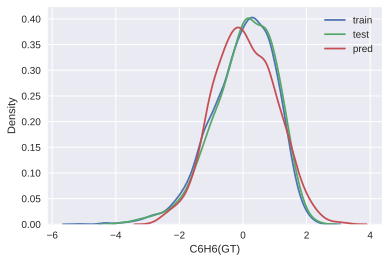

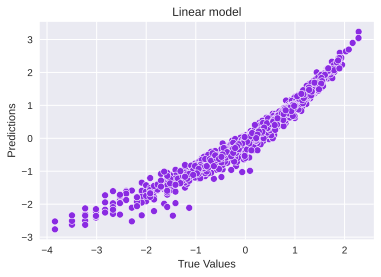

In [ ]:
target_distr_linear(train_label, test_label, predictedDependentVariables) 

**Look at feature importance**

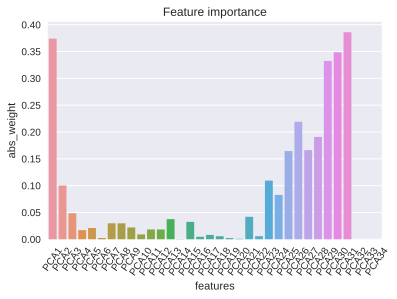

In [ ]:
get_feature_importance(ridgeModel)

* Many features contribute to this model.
* The largest contribution is from PC 1, PC 30, PCA29.
* Some features are extremely small, so you should think about excluding them later.

### **Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


In [ ]:
errors = test_label - predictedDependentVariables

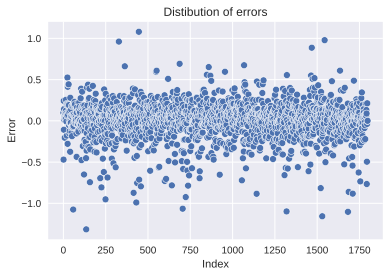

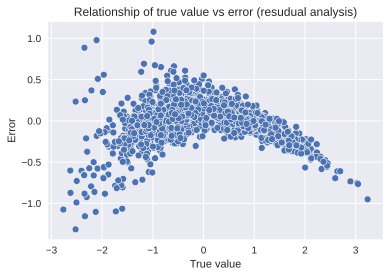

In [ ]:
draw_heteroscedasticity(errors, predictedDependentVariables)

**Conclusion**
* The trend in the second figure is clearly visible, now we will confirm the presence of heteroskedasticity on tests.


**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.

**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testData)

[('F statistic', 0.8653045949131016), ('p-value', 0.9834226959440076)]


**Breush-Pagan test:**

In [ ]:
test_breuschpagan(errors, testData)

[('Lagrange multiplier statistic', 512.8800866122517), ('p-value', 1.9080049399957063e-87), ('f-value', 22.743376532264776), ('f p-value', 3.3599101865124834e-106)]


* The test is significant meaning the data violates the assumption of homoscedasticity, i.e. heteroscedasticity is present in the data. 


### **Metrics**

**Errors on the train**

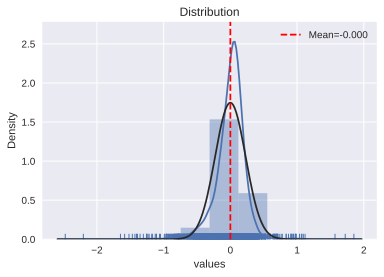

In [ ]:
error = train_label - ridgeModel.predict(trainData)
draw_histogram(error)

* We see that the distribution is not so similar to the normal one - it is slightly tilted to the right, and it has an average expectation of zero. This is exactly what we assumed as the noise distribution.


In [ ]:
calc_metrics(train_label, ridgeModel.predict(trainData), ridgeModel,trainData, train_label)

*** VAL **: 
MSE:   0.05206409460026571
RMSE:  0.22817557844840824
R2:    0.9483020331623203
MAE:   0.15705311991868412
MedAE: 0.11453614033292235
------------------------------
*** Average cross-validation scores ***:
MSE:   0.05313008022601815
RMSE:  0.23047762394551968
R2:    0.9471165020709194
MAE:   0.15818461227353134
MedAE: 0.11492186857839459
------------------------------


**Errors on the test**

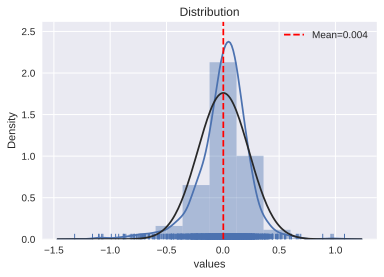

In [ ]:
error = test_label - predictedDependentVariables
draw_histogram(error)

* It can be seen that the variance turned out to be larger on the test, but not much.


In [ ]:
calc_metrics(test_label, predictedDependentVariables, ridgeModel, testData, test_label)

*** VAL **: 
MSE:   0.051380721823404744
RMSE:  0.2266731607919313
R2:    0.9469478364293202
MAE:   0.16030020563926353
MedAE: 0.11589164781826303
------------------------------
*** Average cross-validation scores ***:
MSE:   0.05197641717849381
RMSE:  0.22759036494082135
R2:    0.9461199950857608
MAE:   0.15818543463188484
MedAE: 0.11277112901548418
------------------------------


**Conclusion**

* The errors are about the same as on the train, which means that the model has practically not been retrained. Everything is quite good at the moment.
* R2 score is very close to 1 both on the train and on the test, the values are slightly worse on the test.
* R2 score a little bit higher than in linear model *(now: 0.942047465318729 , was: 0.9420064807501489)*
* Such a high estimate is partly due to heteroscedasticity, which should be excluded from the regression model. In the results, I will describe ways to exclude heteroscedasticity from the data.

### **Hyperparameters tuning**

In [ ]:
ridgeModel = linear_model.RidgeCV(alphas=np.arange(0, 30, 0.1), 
                                  cv=5, 
                                  scoring='neg_root_mean_squared_error')

In [ ]:
ridgeModel.fit(trainData, train_label)

RidgeCV(alphas=array([ 0. ,  0.1,  0.2,  0.3,  0.4,  0.5,  0.6,  0.7,  0.8,  0.9,  1. ,
        1.1,  1.2,  1.3,  1.4,  1.5,  1.6,  1.7,  1.8,  1.9,  2. ,  2.1,
        2.2,  2.3,  2.4,  2.5,  2.6,  2.7,  2.8,  2.9,  3. ,  3.1,  3.2,
        3.3,  3.4,  3.5,  3.6,  3.7,  3.8,  3.9,  4. ,  4.1,  4.2,  4.3,
        4.4,  4.5,  4.6,  4.7,  4.8,  4.9,  5. ,  5.1,  5.2,  5.3,  5.4,
        5.5,  5.6,  5.7,  5.8,  5.9,  6. ,  6.1,  6.2,  6.3,  6.4,  6.5,
        6.6,  6.7,  6.8,  6.9,  7. ,  7.1,  7.2,  7.3,  7.4,  7.5,  7.6,
        7.7,  7.8,  7.9,  8. ,  8.1,  8.2,  8.3,  8...
       24.2, 24.3, 24.4, 24.5, 24.6, 24.7, 24.8, 24.9, 25. , 25.1, 25.2,
       25.3, 25.4, 25.5, 25.6, 25.7, 25.8, 25.9, 26. , 26.1, 26.2, 26.3,
       26.4, 26.5, 26.6, 26.7, 26.8, 26.9, 27. , 27.1, 27.2, 27.3, 27.4,
       27.5, 27.6, 27.7, 27.8, 27.9, 28. , 28.1, 28.2, 28.3, 28.4, 28.5,
       28.6, 28.7, 28.8, 28.9, 29. , 29.1, 29.2, 29.3, 29.4, 29.5, 29.6,
       29.7, 29.8, 29.9]),
        cv=5, fit_intercept

In [ ]:
ridgeModel.alpha_

2.2

The optimal parameter alpha is 2.2

In [ ]:
params = [
    {
        'fit_intercept': [True, False],
        'normalize' : [True, False]
    }
]

In [ ]:
rg_model = linear_model.Ridge(alpha=2.2)
cv = KFold(n_splits=5, shuffle=True, random_state=42)
gs = GridSearchCV(rg_model, params, 
                  n_jobs=-1, 
                  scoring=['neg_mean_squared_error', 'r2'], 
                  refit='neg_mean_squared_error', 
                  cv=cv)

In [ ]:
%%time
gs.fit(trainData,train_label);

CPU times: user 141 ms, sys: 92.3 ms, total: 234 ms
Wall time: 1.55 s


GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             error_score=nan,
             estimator=Ridge(alpha=2.2, copy_X=True, fit_intercept=True,
                             max_iter=None, normalize=False, random_state=None,
                             solver='auto', tol=0.001),
             iid='deprecated', n_jobs=-1,
             param_grid=[{'fit_intercept': [True, False],
                          'normalize': [True, False]}],
             pre_dispatch='2*n_jobs', refit='neg_mean_squared_error',
             return_train_score=False, scoring=['neg_mean_squared_error', 'r2'],
             verbose=0)

In [ ]:
gs.best_params_

{'fit_intercept': False, 'normalize': True}

Now we will train the model with the selected parameters.

In [ ]:
ridgeModel = linear_model.Ridge(alpha=2.2,
                                fit_intercept=False,
                                normalize=True)

ridgeModel.fit(trainData, train_label)

Ridge(alpha=2.2, copy_X=True, fit_intercept=False, max_iter=None,
      normalize=True, random_state=None, solver='auto', tol=0.001)

In [ ]:
predictedDependentVariables = ridgeModel.predict(testData)

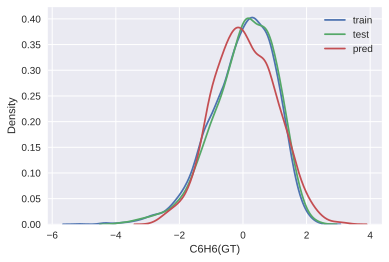

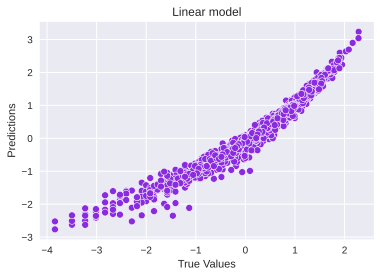

In [ ]:
target_distr_linear(train_label, test_label, predictedDependentVariables) 

**Look at feature importance**

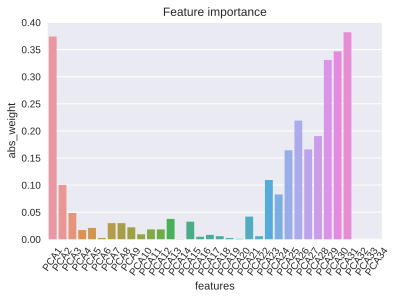

In [ ]:
get_feature_importance(ridgeModel)

* Only a few features have a significant contribution
* Three features(two of them to the greatest extent) play the greatest role in the problem of predictive modeling.
* After tuning of hyperparams. coeffs are similar to 1st linear model.

### **Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


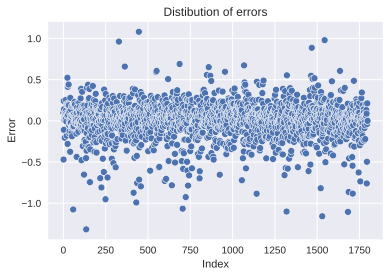

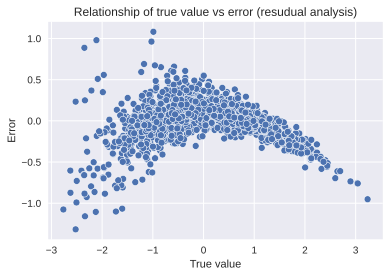

In [ ]:
errors = test_label - predictedDependentVariables

draw_heteroscedasticity(errors, predictedDependentVariables)


**Conclusion**
* The trend in the second figure is clearly visible, now we will confirm the presence of heteroskedasticity on tests.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.

**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testData)

[('F statistic', 0.8652287689045286), ('p-value', 0.9834758169490424)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.

**Breush-Pagan test:**

In [ ]:
test_breuschpagan(errors, testData)

[('Lagrange multiplier statistic', 512.1366796852413), ('p-value', 2.705728074189751e-87), ('f-value', 22.697291016864913), ('f p-value', 5.483769912494196e-106)]


* The test is significant meaning the data violates the assumption of homoscedasticity, i.e. heteroscedasticity is present in the data. 


**The White Test**
* If  dataset has many explanatory variables, the test may be challenging to calculate (looking at correlation table after PCA, I can say, that we should't use this test. 


### **Metrics**

**Errors on the train**

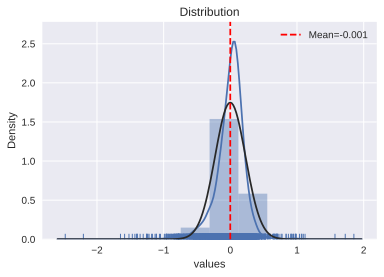

In [ ]:
error = train_label - ridgeModel.predict(trainData)
draw_histogram(error)

In [ ]:
calc_metrics(train_label, ridgeModel.predict(trainData), ridgeModel, trainData, train_label)

*** VAL **: 
MSE:   0.05206616440395906
RMSE:  0.22818011395377788
R2:    0.9482999779140053
MAE:   0.15691331506449083
MedAE: 0.1141047768886103
------------------------------
*** Average cross-validation scores ***:
MSE:   0.05310389880478407
RMSE:  0.23042147030153454
R2:    0.9471437074142255
MAE:   0.1579920811682561
MedAE: 0.11447133888877652
------------------------------


**Errors on the test**

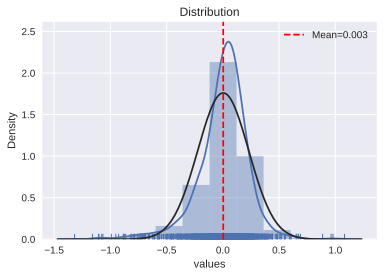

In [ ]:
error = test_label - predictedDependentVariables
draw_histogram(error)

In [ ]:
calc_metrics(test_label, predictedDependentVariables, ridgeModel, testData, test_label)

*** VAL **: 
MSE:   0.051365411300476047
RMSE:  0.2266393860309281
R2:    0.9469636450115655
MAE:   0.16012734291312464
MedAE: 0.11554684361164291
------------------------------
*** Average cross-validation scores ***:
MSE:   0.05199630650104109
RMSE:  0.22762655612852845
R2:    0.9460970617987627
MAE:   0.1585868691943958
MedAE: 0.1135174286957322
------------------------------


**Conclusion** 
* The metric data is not too different.
* However, the r2 score has decreased slightly, perhaps a more fine-tuning of the hyperparameters is needed. *(was: 0.942047465318729, became: 0.9416111617094247)*
* Such a high estimate is partly due to heteroscedasticity, which should be excluded from the regression model. In the results, I will describe ways to exclude heteroscedasticity from the data.

## **Lasso regression**  
### **Simple model**

In [ ]:
lassoModel = linear_model.Lasso()

In [ ]:
lassoModel.fit(trainData, train_label)

Lasso(alpha=1.0, copy_X=True, fit_intercept=True, max_iter=1000,
      normalize=False, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)

In [ ]:
predictedDependentVariables = lassoModel.predict(testData)

At first, estimate the distribution of the target variable on the graph.

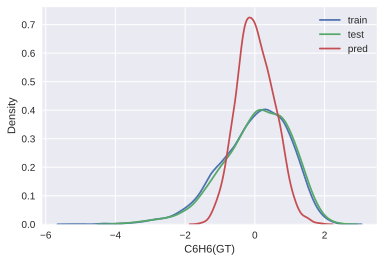

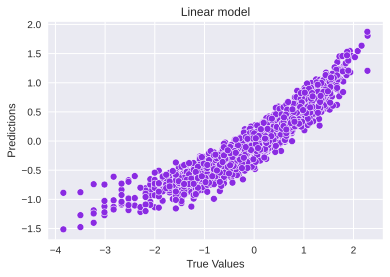

In [ ]:
target_distr_linear(train_label, test_label, predictedDependentVariables)   

**Look at feature importance**

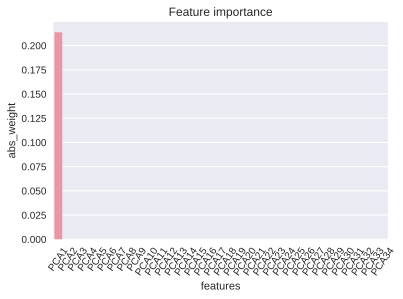

In [ ]:
get_feature_importance(lassoModel)

* Only one feature has a significant contribution on model.
* Scores are not so high as they could be.

### **Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


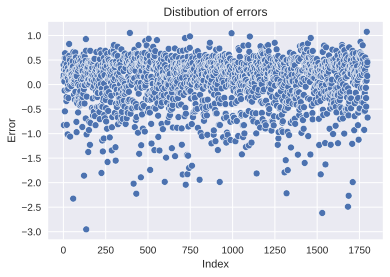

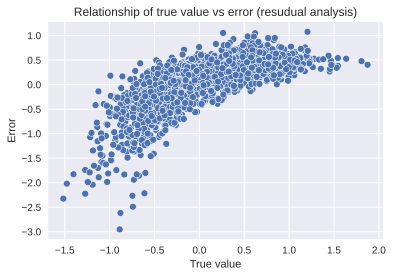

In [ ]:
errors = test_label - predictedDependentVariables

draw_heteroscedasticity(errors, predictedDependentVariables)

**Conclusion**
* The trend in the second figure is clearly visible, now we will confirm the presence of heteroskedasticity on tests.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.

**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testData)

[('F statistic', 0.8658164983917022), ('p-value', 0.9830603586816771)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.

**Breush-Pagan test:**

In [ ]:
test_breuschpagan(errors, testData)

[('Lagrange multiplier statistic', 410.27090784653035), ('p-value', 1.1646743088060567e-66), ('f-value', 16.84898546798847), ('f p-value', 3.9465784231450716e-78)]


* The test is significant meaning the data violates the assumption of homoscedasticity, i.e. heteroscedasticity is present in the data. 


### **Metrics**


**Errors on the train**

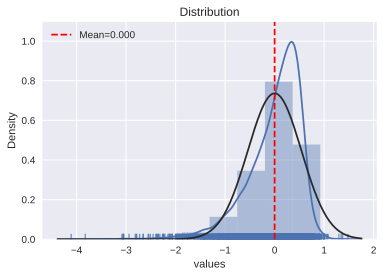

In [ ]:
error = train_label - lassoModel.predict(trainData)
draw_histogram(error)

* This distribution does not look like a normal one, the dome is strongly shifted to the right. Tails of different lengths are visible.

In [ ]:
calc_metrics(train_label, lassoModel.predict(trainData), lassoModel,trainData, train_label)

*** VAL **: 
MSE:   0.2934582126706501
RMSE:  0.5417178349202194
R2:    0.7086054590332855
MAE:   0.4107617466229855
MedAE: 0.3475395097803907
------------------------------
*** Average cross-validation scores ***:
MSE:   0.29376185847373976
RMSE:  0.5417543938307876
R2:    0.7083992566310605
MAE:   0.4109263364346908
MedAE: 0.34740996418383224
------------------------------


**Errors on the test**

In [ ]:
calc_metrics(test_label, predictedDependentVariables, lassoModel, testData, test_label)

*** VAL **: 
MSE:   0.27699051931999386
RMSE:  0.5262988878194537
R2:    0.7139988342515255
MAE:   0.40531917305614296
MedAE: 0.35172951726398777
------------------------------
*** Average cross-validation scores ***:
MSE:   0.28905374427277675
RMSE:  0.5375539168024943
R2:    0.7009087804073527
MAE:   0.4088035168603934
MedAE: 0.3482555815182747
------------------------------


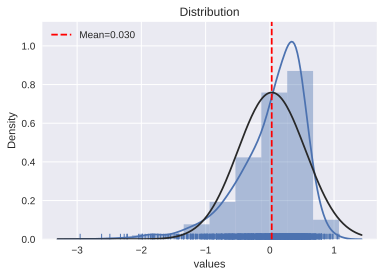

In [ ]:
error = test_label - predictedDependentVariables
draw_histogram(error)

* It can be seen that the variance turned out to be larger on the test.

**Conclusion**
* The model was retrained. The probability of error of the trained algorithm on the objects of the test sample was significantly higher than the average error on the training sample.

### **Hyperparameters tuning**

In [ ]:
lassoModel = linear_model.LassoCV(alphas=np.arange(200, 400, 0.1), 
                                  normalize=True,
                                  cv=5)

In [ ]:
lassoModel.fit(trainData, train_label)

LassoCV(alphas=array([200. , 200.1, 200.2, ..., 399.7, 399.8, 399.9]),
        copy_X=True, cv=5, eps=0.001, fit_intercept=True, max_iter=1000,
        n_alphas=100, n_jobs=None, normalize=True, positive=False,
        precompute='auto', random_state=None, selection='cyclic', tol=0.0001,
        verbose=False)

In [ ]:
lassoModel.alpha_

399.8999999999886

The optimal parameter alpha is 400

In [ ]:
params = [
    {
        'fit_intercept': [True, False],
        'normalize' : [True, False]
    }
]

In [ ]:
ls_model = linear_model.Lasso(alpha=400)
cv = KFold(n_splits=5, shuffle=True, random_state=42)
gs = GridSearchCV(ls_model, params, 
                  n_jobs=-1, 
                  scoring=['neg_mean_squared_error', 'r2'], 
                  refit='neg_mean_squared_error', 
                  cv=cv)

In [ ]:
%%time
gs.fit(trainData,train_label);

CPU times: user 145 ms, sys: 76.5 ms, total: 221 ms
Wall time: 1.54 s


GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             error_score=nan,
             estimator=Lasso(alpha=400, copy_X=True, fit_intercept=True,
                             max_iter=1000, normalize=False, positive=False,
                             precompute=False, random_state=None,
                             selection='cyclic', tol=0.0001, warm_start=False),
             iid='deprecated', n_jobs=-1,
             param_grid=[{'fit_intercept': [True, False],
                          'normalize': [True, False]}],
             pre_dispatch='2*n_jobs', refit='neg_mean_squared_error',
             return_train_score=False, scoring=['neg_mean_squared_error', 'r2'],
             verbose=0)

In [ ]:
gs.best_params_

{'fit_intercept': False, 'normalize': True}

Now we will train the model with the selected parameters

In [ ]:
lasso_model = linear_model.Lasso(alpha=400, fit_intercept=False, normalize=True)

lasso_model.fit(trainData, train_label)

Lasso(alpha=400, copy_X=True, fit_intercept=False, max_iter=1000,
      normalize=True, positive=False, precompute=False, random_state=None,
      selection='cyclic', tol=0.0001, warm_start=False)

In [ ]:
predictedDependentVariables = lasso_model.predict(testData)

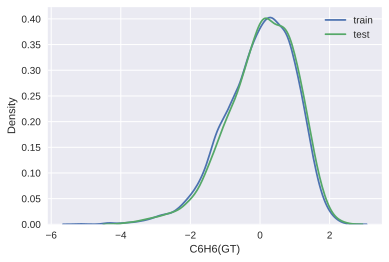

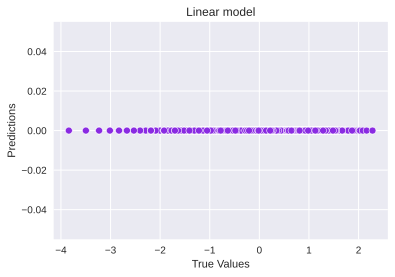

In [ ]:
target_distr_linear(train_label, test_label, predictedDependentVariables) 

**Look at feature importance**

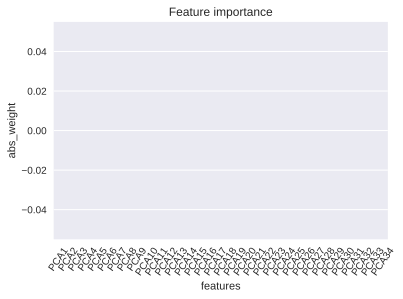

In [ ]:
get_feature_importance(lassoModel)

* Features have no impact on model.
* This model is not suitable here.

**Errors on the train**

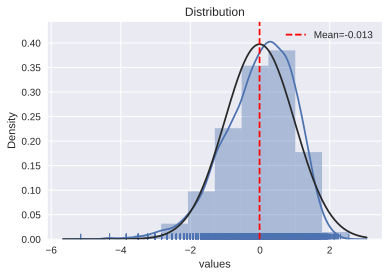

In [ ]:
error = train_label - lasso_model.predict(trainData)
draw_histogram(error)

In [ ]:
calc_metrics(train_label, lasso_model.predict(trainData), lasso_model,trainData, train_label)

*** VAL **: 
MSE:   1.007241871347644
RMSE:  1.0036144037167083
R2:    -0.00015869405298740702
MAE:   0.7976088007932048
MedAE: 0.6935261874986057
------------------------------
*** Average cross-validation scores ***:
MSE:   1.0072320848168776
RMSE:  1.0034383272467813
R2:    -0.0006539213665916144
MAE:   0.7976050027317676
MedAE: 0.6995503116364169
------------------------------


**Errors on the test**

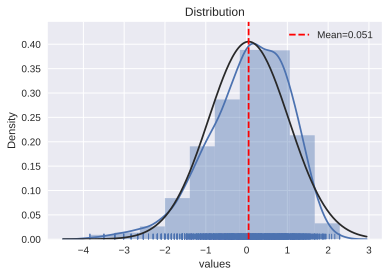

In [ ]:
error = test_label - predictedDependentVariables
draw_histogram(error)

In [ ]:
calc_metrics(test_label, predictedDependentVariables, lasso_model, testData, test_label)

*** VAL **: 
MSE:   0.9710486166024135
RMSE:  0.985417990805127
R2:    -0.002637335850097733
MAE:   0.7866751960724876
MedAE: 0.6910663264226198
------------------------------
*** Average cross-validation scores ***:
MSE:   0.9710240418951261
RMSE:  0.9852754979477822
R2:    -0.0044605119490330305
MAE:   0.786667890070974
MedAE: 0.6996643540757742
------------------------------


**Conclusion**
* After tuning the hyperparameters, the model's metrics fell even more. The model does not know how to predict.

# **Polynomial regression**

## **Quadratic regression**

### **Simple model**

In [ ]:
poly = PolynomialFeatures(degree=2, include_bias=False)
poly.fit(trainData)

poly_train = poly.transform(trainData)
poly_test = poly.transform(testData)

print('Original number of features:', trainData.shape[1])
print('Number of features after polynomial transformation:', poly_train.shape[1])

Original number of features: 34
Number of features after polynomial transformation: 629


In [ ]:
regressionModel = linear_model.LinearRegression(normalize=True)
regressionModel.fit(poly_train, train_label)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=True)

In [ ]:
predictedDependentVariables = regressionModel.predict(poly_test)

At first, estimate the distribution of the target variable on the graph.

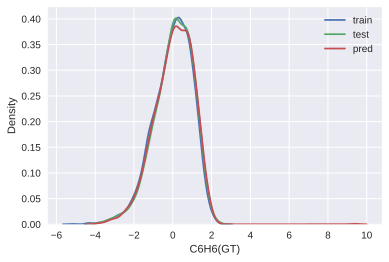

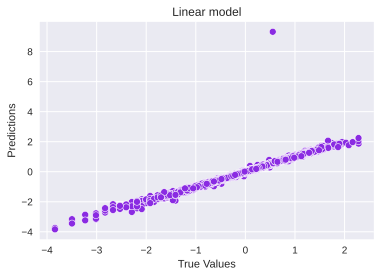

In [ ]:
target_distr_linear(train_label, test_label, predictedDependentVariables) 

**Look at top 15 feature importance**

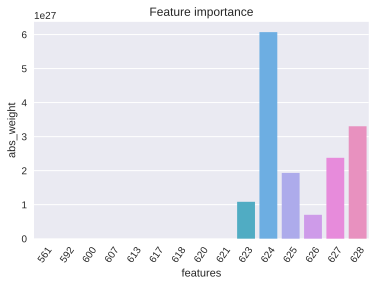

In [ ]:
coef_table = pd.DataFrame([x for x in range(poly_train.shape[1])]).copy()
coef_table.insert(len(coef_table.columns),"Coefs",np.abs(regressionModel.coef_).transpose())

coef_table = coef_table.sort_values(by='Coefs', ascending=False)[:15]

sns.barplot(x=0, y='Coefs', data=coef_table)
plt.title('Feature importance')
plt.xlabel('features')
plt.ylabel('abs_weight')
plt.xticks(rotation=55)
plt.show()

* Only a few features have a significant contribution
* Three feature play the greatest role in the problem of predictive modeling.


### **Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


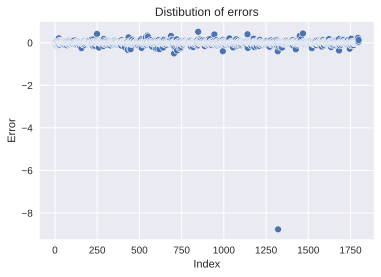

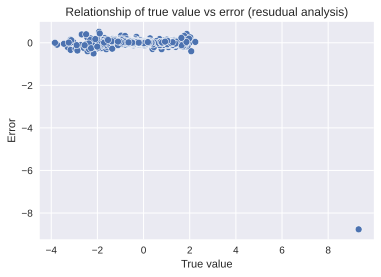

In [ ]:
errors = test_label - predictedDependentVariables
draw_heteroscedasticity(errors, predictedDependentVariables)

**Conclusion**
* The trend in the second figure is clearly visible, now we will confirm the presence of heteroskedasticity on tests.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.

**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testData)

[('F statistic', 2.2221482829256467), ('p-value', 1.7841913091117307e-31)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.

**Breush-Pagan test:**


In [ ]:
test_breuschpagan(errors, testData)

[('Lagrange multiplier statistic', 26.937199156647544), ('p-value', 0.7624191167558363), ('f-value', 0.8669496888631973), ('f p-value', 0.6776193598533468)]


* The test is significant meaning the data violates the assumption of homoscedasticity, i.e. heteroscedasticity is present in the data. 


### **Metrics**

**Errors on the train**

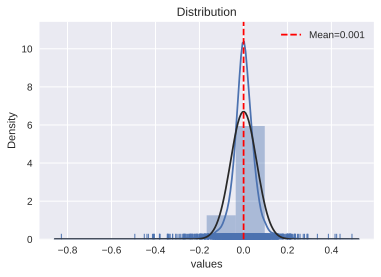

In [ ]:
error = train_label - regressionModel.predict(poly_train)
draw_histogram(error)

* We see that the distribution is similar to the normal one - it is symmetrical, and it has an average expectation of zero. This is exactly what we assumed as the noise distribution.


In [ ]:
calc_metrics(train_label, regressionModel.predict(poly_train), regressionModel,poly_train, train_label)

*** VAL **: 
MSE:   0.003539113413856266
RMSE:  0.05949044808922073
R2:    0.9964857745187142
MAE:   0.03864865157428472
MedAE: 0.026273928079392522
------------------------------
*** Average cross-validation scores ***:
MSE:   0.010066832419611847
RMSE:  0.09164239807109112
R2:    0.9899167138827707
MAE:   0.04577046777304221
MedAE: 0.029319654456491494
------------------------------


**Errors on the test**

In [ ]:
calc_metrics(test_label,  regressionModel.predict(poly_test), regressionModel,poly_test, test_label)

*** VAL **: 
MSE:   0.04742143759996079
RMSE:  0.21776463808424176
R2:    0.9510359182388148
MAE:   0.048035303589798635
MedAE: 0.02817751595875384
------------------------------
*** Average cross-validation scores ***:
MSE:   0.02313144593956032
RMSE:  0.13385492994339993
R2:    0.9760889371594544
MAE:   0.05684448791143687
MedAE: 0.03345167746537317
------------------------------


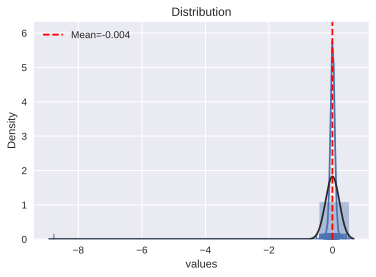

In [ ]:
error = test_label - regressionModel.predict(poly_test)
draw_histogram(error)

* It can be seen that the variance turned out to be significantly larger on the test, doesn't look like a normal distribution.


In [ ]:
error = abs(test_label - regressionModel.predict(poly_test))
np.quantile(error, np.arange(0, 1.01, 0.1))

array([4.53131934e-06, 5.16022431e-03, 1.05766854e-02, 1.57348058e-02,
       2.16668471e-02, 2.81775160e-02, 3.61615969e-02, 4.56897847e-02,
       6.11970661e-02, 9.15119181e-02, 8.76846700e+00])

**Conclusion**
* The quality has become noticeably worse compared to the linear model. Everything is very bad - the model has retrained.
* **!** This can be corrected by regularization.

### **Regularization & Hyperparameters tuning**

In [ ]:
ridgeModel = linear_model.RidgeCV(alphas=np.arange(0, 30, 0.1), 
                                  cv=5, 
                                  scoring='neg_root_mean_squared_error')

In [ ]:
ridgeModel.fit(poly_train, train_label)

RidgeCV(alphas=array([ 0. ,  0.1,  0.2,  0.3,  0.4,  0.5,  0.6,  0.7,  0.8,  0.9,  1. ,
        1.1,  1.2,  1.3,  1.4,  1.5,  1.6,  1.7,  1.8,  1.9,  2. ,  2.1,
        2.2,  2.3,  2.4,  2.5,  2.6,  2.7,  2.8,  2.9,  3. ,  3.1,  3.2,
        3.3,  3.4,  3.5,  3.6,  3.7,  3.8,  3.9,  4. ,  4.1,  4.2,  4.3,
        4.4,  4.5,  4.6,  4.7,  4.8,  4.9,  5. ,  5.1,  5.2,  5.3,  5.4,
        5.5,  5.6,  5.7,  5.8,  5.9,  6. ,  6.1,  6.2,  6.3,  6.4,  6.5,
        6.6,  6.7,  6.8,  6.9,  7. ,  7.1,  7.2,  7.3,  7.4,  7.5,  7.6,
        7.7,  7.8,  7.9,  8. ,  8.1,  8.2,  8.3,  8...
       24.2, 24.3, 24.4, 24.5, 24.6, 24.7, 24.8, 24.9, 25. , 25.1, 25.2,
       25.3, 25.4, 25.5, 25.6, 25.7, 25.8, 25.9, 26. , 26.1, 26.2, 26.3,
       26.4, 26.5, 26.6, 26.7, 26.8, 26.9, 27. , 27.1, 27.2, 27.3, 27.4,
       27.5, 27.6, 27.7, 27.8, 27.9, 28. , 28.1, 28.2, 28.3, 28.4, 28.5,
       28.6, 28.7, 28.8, 28.9, 29. , 29.1, 29.2, 29.3, 29.4, 29.5, 29.6,
       29.7, 29.8, 29.9]),
        cv=5, fit_intercept

In [ ]:
ridgeModel.alpha_

4.2

The optimal parameter alpha is 4.2

In [ ]:
params = [
    {
        'fit_intercept': [True, False],
        'normalize' : [True, False]
    }
]

In [ ]:
rg_model = linear_model.Ridge(alpha=4.2)
cv = KFold(n_splits=5, shuffle=True, random_state=42)
gs = GridSearchCV(rg_model, params, 
                  n_jobs=-1, 
                  scoring=['neg_mean_squared_error', 'r2'], 
                  refit='neg_mean_squared_error', 
                  cv=cv)

In [ ]:
%%time
gs.fit(poly_train,train_label);

CPU times: user 383 ms, sys: 184 ms, total: 567 ms
Wall time: 3.8 s


GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             error_score=nan,
             estimator=Ridge(alpha=4.2, copy_X=True, fit_intercept=True,
                             max_iter=None, normalize=False, random_state=None,
                             solver='auto', tol=0.001),
             iid='deprecated', n_jobs=-1,
             param_grid=[{'fit_intercept': [True, False],
                          'normalize': [True, False]}],
             pre_dispatch='2*n_jobs', refit='neg_mean_squared_error',
             return_train_score=False, scoring=['neg_mean_squared_error', 'r2'],
             verbose=0)

In [ ]:
gs.best_params_

{'fit_intercept': False, 'normalize': True}

Now we will train the model with the selected parameters.

In [ ]:
regressionModel = linear_model.Ridge(alpha=4.2,
                                fit_intercept=False,
                                normalize=True)
regressionModel.fit(poly_train, train_label)

Ridge(alpha=4.2, copy_X=True, fit_intercept=False, max_iter=None,
      normalize=True, random_state=None, solver='auto', tol=0.001)

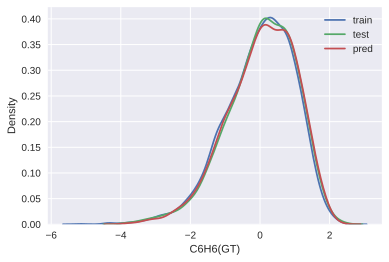

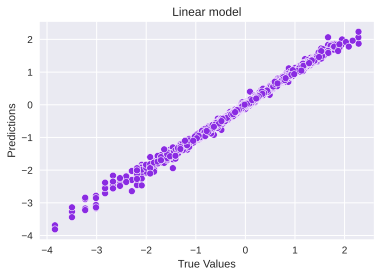

In [ ]:
target_distr_linear(train_label, test_label, regressionModel.predict(poly_test))

**Look at feature importance**

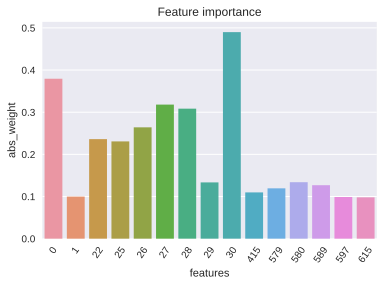

In [ ]:
coef_table = pd.DataFrame([x for x in range(poly_train.shape[1])]).copy()
coef_table.insert(len(coef_table.columns),"Coefs",np.abs(regressionModel.coef_).transpose())

coef_table = coef_table.sort_values(by='Coefs', ascending=False)[:15]

sns.barplot(x=0, y='Coefs', data=coef_table)
plt.title('Feature importance')
plt.xlabel('features')
plt.ylabel('abs_weight')
plt.xticks(rotation=55)
plt.show()

* After setting up the hyperparameters, more features began to play a role in this model, but one feature stands out most from the rest.

### **Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


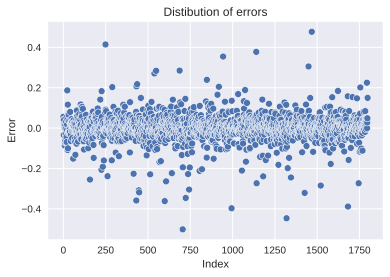

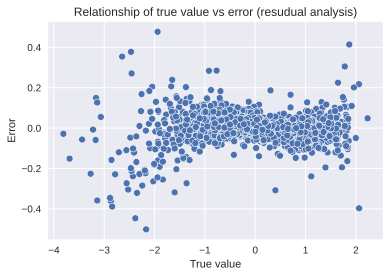

In [ ]:
errors = test_label - regressionModel.predict(poly_test)

draw_heteroscedasticity(errors, regressionModel.predict(poly_test))


**Conclusion**
* The trend in the second figure is clearly visible, now we will confirm the presence of heteroskedasticity on tests.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.

**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.


In [ ]:
test_goldfeldquandt(errors, poly_test)

[('F statistic', 0.8983430040538556), ('p-value', 0.8758079470622573)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.


### **Metrics**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


**Errors on the train**

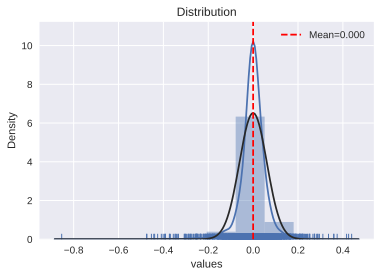

In [ ]:
error = train_label - regressionModel.predict(poly_train) 
draw_histogram(error)

In [ ]:
calc_metrics(train_label, regressionModel.predict(poly_train), regressionModel,poly_train, train_label)

*** VAL **: 
MSE:   0.003742693480776988
RMSE:  0.06117755700235985
R2:    0.9962836260778494
MAE:   0.039359279018884245
MedAE: 0.02608934309277741
------------------------------
*** Average cross-validation scores ***:
MSE:   0.004963810258734963
RMSE:  0.07037900143498423
R2:    0.9950606413397386
MAE:   0.04345153827722904
MedAE: 0.027904985924928453
------------------------------


**Errors on the test**

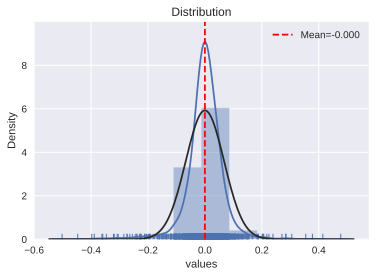

In [ ]:
error = test_label - regressionModel.predict(poly_test)
draw_histogram(error)

In [ ]:
calc_metrics(test_label, regressionModel.predict(poly_test), regressionModel,poly_test, test_label)

*** VAL **: 
MSE:   0.004532811206289204
RMSE:  0.0673261554396893
R2:    0.995319734075018
MAE:   0.04272854547249428
MedAE: 0.02815673866582924
------------------------------
*** Average cross-validation scores ***:
MSE:   0.006821458590760769
RMSE:  0.08235517411135783
R2:    0.9929116660823771
MAE:   0.05396024039495312
MedAE: 0.035974267029896506
------------------------------


**Conclusion**
* The model shows extremely good results.
* Even the average value of the metrics obtained during cross validation is very high and bypasses all the models presented in this document with its results.
* Such a high estimate is partly due to heteroscedasticity, which should be excluded from the regression model. In the results, I will describe ways to exclude heteroscedasticity from the data.

# **ElasticNet**  
## **Simple model**

In [ ]:
elnetModel = linear_model.ElasticNet(random_state=42)

In [ ]:
elnetModel.fit(trainData, train_label)

ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True, l1_ratio=0.5,
           max_iter=1000, normalize=False, positive=False, precompute=False,
           random_state=42, selection='cyclic', tol=0.0001, warm_start=False)

In [ ]:
predictedDependentVariables = elnetModel.predict(testData)

At first, estimate the distribution of the target variable on the graph.

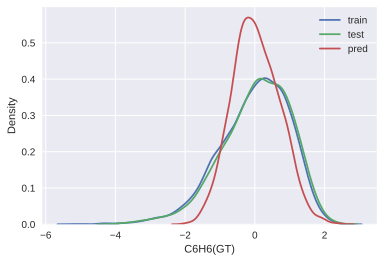

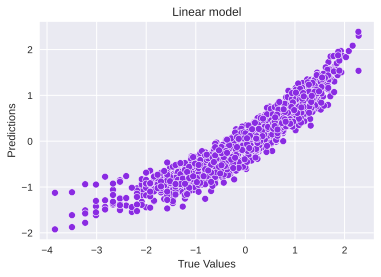

In [ ]:
target_distr_linear(train_label, test_label, predictedDependentVariables)  

**Look at feature importance**

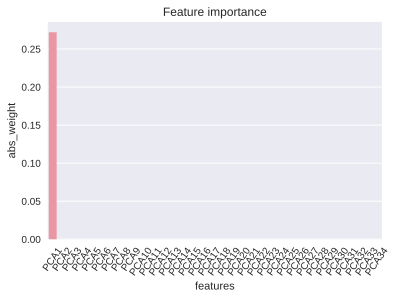

In [ ]:
get_feature_importance(elnetModel)


* Only one feature has a significant contribution on model.
* Scores here are not so good.
* We can think about removing features that do not contribute to the model.

### **Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


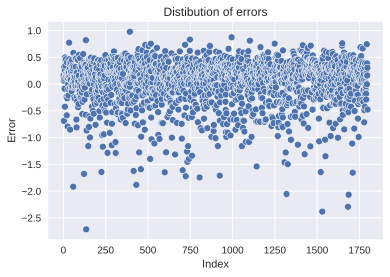

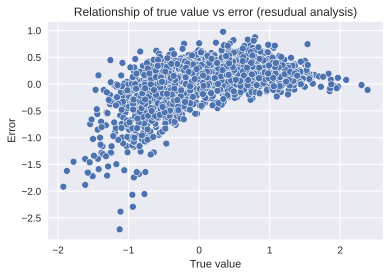

In [ ]:
errors = test_label - predictedDependentVariables

draw_heteroscedasticity(errors, predictedDependentVariables)

**Conclusion**
* The trend in the second figure is clearly visible, now we will confirm the presence of heteroskedasticity on tests.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.

**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.

In [ ]:
test_goldfeldquandt(errors, testData)

[('F statistic', 0.8656160083111251), ('p-value', 0.9832030439365645)]


* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.

**Breush-Pagan test:**

In [ ]:
test_breuschpagan(errors, testData)

[('Lagrange multiplier statistic', 383.4005763324251), ('p-value', 2.8022722068731668e-61), ('f-value', 15.446601804077819), ('f p-value', 3.3834083309506935e-71)]


since the p-value is less than 0.05, we reject the null hypothesis and conclude that the residuals are heteroskedastic.

### **Metrics**

**Errors on the train**

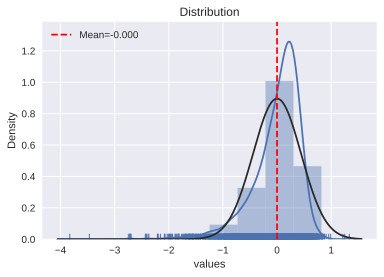

In [ ]:
error = train_label - elnetModel.predict(trainData)
draw_histogram(error)

* The distribution does not look like a normal one, it is slightly shifted to the right, has a long left tail.


In [ ]:
calc_metrics(train_label, elnetModel.predict(trainData), elnetModel,trainData, train_label)

*** VAL **: 
MSE:   0.19828807261140946
RMSE:  0.4452954890984294
R2:    0.8031063388141633
MAE:   0.3279931481246594
MedAE: 0.26465961860159337
------------------------------
*** Average cross-validation scores ***:
MSE:   0.19850080152195365
RMSE:  0.4453409564492022
R2:    0.8029415621618046
MAE:   0.3281084603662627
MedAE: 0.26400699715378007
------------------------------


**Errors on the test**

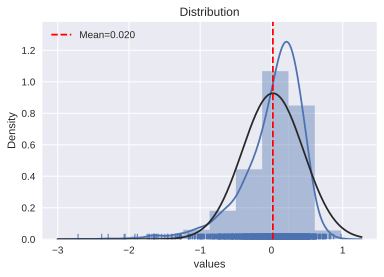

In [ ]:
error = test_label - predictedDependentVariables
draw_histogram(error)

In [ ]:
calc_metrics(test_label, predictedDependentVariables, elnetModel,testData, test_label)

*** VAL **: 
MSE:   0.1855663741063012
RMSE:  0.4307741567298359
R2:    0.8083970547136023
MAE:   0.3217403869292251
MedAE: 0.2630285251209352
------------------------------
*** Average cross-validation scores ***:
MSE:   0.19161763322205877
RMSE:  0.4376656809778147
R2:    0.801576057213785
MAE:   0.32313853304030166
MedAE: 0.26224976639599823
------------------------------


**Conclusion**
* Model works normal, but scores are highly differ from 1st linear model. So, it is important to tune hyperparameters. 
* Heteroscedasticity is present in the data and affects the metrics.

## **Hyperparameters tuning**

In [ ]:
params = {
    'alpha': np.linspace(0, 300, 10),
    'l1_ratio': np.arange(0, 1.1, 0.1),
    'fit_intercept': [True, False],
    'normalize' : [True, False]
}

In [ ]:
en_model = linear_model.ElasticNet(random_state=42)
cv = KFold(n_splits=5, shuffle=True, random_state=42)
gs = GridSearchCV(en_model, params, 
                  n_jobs=-1, 
                  scoring=['neg_mean_squared_error', 'r2'], 
                  refit='neg_mean_squared_error', 
                  cv=cv)

In [ ]:
%%time
gs.fit(trainData,train_label);

CPU times: user 5.19 s, sys: 701 ms, total: 5.89 s
Wall time: 1min 35s


GridSearchCV(cv=KFold(n_splits=5, random_state=42, shuffle=True),
             error_score=nan,
             estimator=ElasticNet(alpha=1.0, copy_X=True, fit_intercept=True,
                                  l1_ratio=0.5, max_iter=1000, normalize=False,
                                  positive=False, precompute=False,
                                  random_state=42, selection='cyclic',
                                  tol=0.0001, warm_start=False),
             iid='deprecated', n_jobs=-1,
             param_grid={'alpha': array([  0.        ,  33.33333333,  66.66666667, 100.        ,
       133.33333333, 166.66666667, 200.        , 233.33333333,
       266.66666667, 300.        ]),
                         'fit_intercept': [True, False],
                         'l1_ratio': array([0. , 0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. ]),
                         'normalize': [True, False]},
             pre_dispatch='2*n_jobs', refit='neg_mean_squared_error',
             return_t

In [ ]:
gs.best_params_

{'alpha': 0.0, 'fit_intercept': False, 'l1_ratio': 0.0, 'normalize': True}

Now we will train the model with the selected parameters

In [ ]:
elnetModel = linear_model.ElasticNet(random_state=42,
                                     alpha=0.0,
                                     l1_ratio=0.0,
                                     normalize=True,
                                     fit_intercept=False)
elnetModel.fit(trainData, train_label)

ElasticNet(alpha=0.0, copy_X=True, fit_intercept=False, l1_ratio=0.0,
           max_iter=1000, normalize=True, positive=False, precompute=False,
           random_state=42, selection='cyclic', tol=0.0001, warm_start=False)

In [ ]:
predictedDependentVariables = elnetModel.predict(testData)

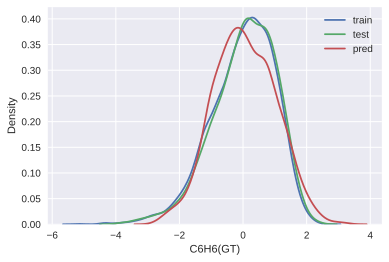

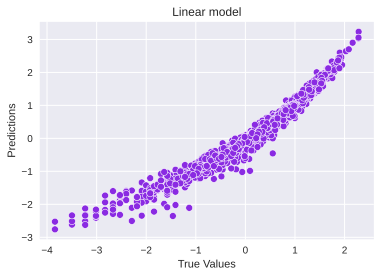

In [ ]:
target_distr_linear(train_label, test_label, predictedDependentVariables) 

**Look at feature importance**

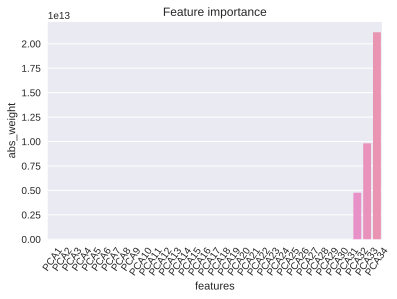

In [ ]:
get_feature_importance(elnetModel) 

* Only one feature has a significant contribution on model.
* Scores here are not so good.
* We can think about removing features that do not contribute to the model.

**Errors on the train**

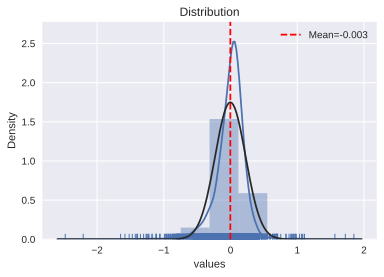

In [ ]:
error = train_label - elnetModel.predict(trainData)
draw_histogram(error)

In [ ]:
calc_metrics(train_label, elnetModel.predict(trainData), elnetModel,trainData, train_label)

*** VAL **: 
MSE:   0.05201305106761104
RMSE:  0.2280636995832766
R2:    0.9483527177440598
MAE:   0.15671678521179178
MedAE: 0.11423522325122441
------------------------------
*** Average cross-validation scores ***:
MSE:   0.05329140679848813
RMSE:  0.23082420245243088
R2:    0.9469530061244923
MAE:   0.1581415052058241
MedAE: 0.11411217216473017
------------------------------


**Errors on the test**

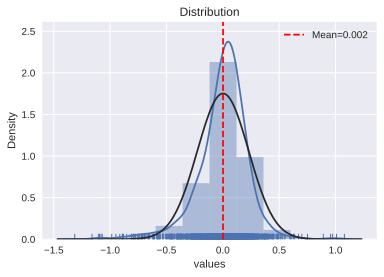

In [ ]:
error = test_label - predictedDependentVariables
draw_histogram(error)

In [ ]:
calc_metrics(test_label, predictedDependentVariables, elnetModel,testData, test_label)

*** VAL **: 
MSE:   0.05182353677283975
RMSE:  0.22764783498386218
R2:    0.9464906164780376
MAE:   0.16027397157328999
MedAE: 0.11652008417876192
------------------------------
*** Average cross-validation scores ***:
MSE:   0.05273314894333594
RMSE:  0.22935627658105107
R2:    0.9453367993619686
MAE:   0.1590329219084937
MedAE: 0.11470204032605694
------------------------------


**Conclusion**
* At 1st glance, setting up hyperparameters greatly helped to improve the model, the values on the test and the train differ little, the model was well trained.
* However, looking at average cross-validation scores , we can observe that model was retrained.
* Such a high estimate is partly due to heteroscedasticity, which should be excluded from the regression model. In the results, I will describe ways to exclude heteroscedasticity from the data.

# **General conclusion**

* Heteroscedasticity was found in the data, which is bad for the regression model. Heteroscedasticity, the violation of homoscedasticity, occurs when we don’t have Why it can happen: Our model may be giving too much weight to a subset of the data, particularly where the error variance was the largest.

**What it will affect:** Significance tests for coefficients due to the standard errors being biased. Additionally, the confidence intervals will be either too wide or too narrow.

**How to detect it:** Plot the residuals and see if the variance appears to be uniform.

**How to fix it:** Heteroscedasticity  can be solved either by using weighted least squares regression instead of the standard OLS. One way to get rig of this thing is to penalize the points at larger variances. If we are seeking a linear fit to the data, the points with the larger noise/errors should be of lower influence than the points that lie close together. Enter weighted least squares (WLS) – in this method, the weights for each datapoint is scaled inversely as a function of its variance, thereby achieving the above goal.
Or transforming either the dependent or highly skewed variables. Performing a box-cox or a log transformation on the dependent variable is not a bad place to start.

---------------------------------------------------------

The PCA algorithm was used to eliminate multicollinearity.

**Results:** 

* The best results on both the train and the test with a slight difference in performance were shown by *quadratic regression* after tuning hyperparameters.

**TRAIN**  

*** Val **:   
MSE:   0.003742693480776988  
RMSE:  0.06117755700235985  
R2:    0.9962836260778494  
MAE:   0.039359279018884245  
MedAE: 0.02608934309277741  

*** Average cross-validation scores ***:  
MSE:   0.004963810258734963  
RMSE:  0.07037900143498423  
R2:    0.9950606413397386  
MAE:   0.04345153827722904  
MedAE: 0.027904985924928453  

------------------------------  

**TEST**  

***Val***:    
MSE:   0.004532811206289204  
RMSE:  0.0673261554396893  
R2:    0.995319734075018  
MAE:   0.04272854547249428  
MedAE: 0.02815673866582924  

*** Average cross-validation scores ***:  
MSE:   0.006821458590760769  
RMSE:  0.08235517411135783  
R2:    0.9929116660823771  
MAE:   0.05396024039495312  
MedAE: 0.035974267029896506  

------------------------------    

* After I built several models, and also carried out some tuning of hyperparameters, basically the R2 score, for example, was not higher than *R2: 0.94...* both on train and test, but I wanted to get a higher score.
* Next, it was decided to use polynomial regression, it predicts the most suitable line that follows the data pattern (curve). Polynomial regression does not require that the relationship between independent and dependent variables be linear in the data set. This is also one of the main differences between linear and polynomial regression.
Polynomial regression is usually used when the points in the data are not captured by the linear regression model and the linear regression cannot clearly describe the best result.

* The lass regression proved to be the worst on the presented data, the model was greatly retrained.
* Also, probably next time you can try to exclude months and time from the data(morning, afternoon, evening, night), since it was impossible to check. are the data cyclical in nature, since the dataset was presented in just a year and some dependencies were identified during this time.
* I also think that it is possible to improve the simple linear model and other models with weaker indicators, with the help of more fine-tuning of hyperparameters.

# **II variant**
* An attempt to get rid of heteroscedasticity by transforming the box-cox data, as well as removing some strongly correlated features to avoid multicollinearity.

In [ ]:
new_df = pd.read_csv('/content/drive/My Drive/DA/HW4/Data/AirQualityUCI.csv', sep=';',  na_values='-200')
new_df.drop_duplicates(inplace=True)
new_df.drop(['Unnamed: 15',	'Unnamed: 16'],
           axis=1, inplace=True)
new_df.head(3).T

,0,1,2
Date,10/03/2004,10/03/2004,10/03/2004
Time,18.00.00,19.00.00,20.00.00
CO(GT),"2,6",2,"2,2"
PT08.S1(CO),1360,1292,1402
NMHC(GT),150,112,88
C6H6(GT),"11,9","9,4","9,0"
PT08.S2(NMHC),1046,955,939
NOx(GT),166,103,131
PT08.S3(NOx),1056,1174,1140
NO2(GT),113,92,114


**Converting data types**

In [ ]:
conv_to_float = ['CO(GT)', 'C6H6(GT)', 'T', 'RH', 'AH']
new_df = new_df.replace(',','.', regex=True)
for column in conv_to_float:
  new_df[column] = new_df[column].astype('float64')
new_df.head(3)

,Date,Time,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
0,10/03/2004,18.00.00,2.6,1360.0,150.0,11.9,1046.0,166.0,1056.0,113.0,1692.0,1268.0,13.6,48.9,0.7578
1,10/03/2004,19.00.00,2.0,1292.0,112.0,9.4,955.0,103.0,1174.0,92.0,1559.0,972.0,13.3,47.7,0.7255
2,10/03/2004,20.00.00,2.2,1402.0,88.0,9.0,939.0,131.0,1140.0,114.0,1555.0,1074.0,11.9,54.0,0.7502


**missing data**

In [ ]:
new_df.drop('NMHC(GT)', axis=1, inplace=True)

total = new_df.isnull().sum().sort_values(ascending=False)
missing_data = pd.concat([total], axis=1, keys=['Total'])
missing_data.head(20)

new_df.dropna(thresh=new_df.shape[1]-10, axis=0, inplace=True)

cols = ['NO2(GT)', 'NOx(GT)', 'CO(GT)', 'AH', 'RH', 'T', 'PT08.S5(O3)', 'PT08.S4(NO2)', 'PT08.S3(NOx)', 
        'PT08.S2(NMHC)', 'PT08.S1(CO)']
for сolumn in cols:
    avarage = new_df.loc[:, сolumn].median(skipna = True)
    new_df.loc[:, сolumn].fillna(avarage, inplace=True)
    print(f"{сolumn}: average value --> {avarage}")

NO2(GT): average value --> 109.0
NOx(GT): average value --> 180.0
CO(GT): average value --> 1.8
AH: average value --> 0.9954
RH: average value --> 49.6
T: average value --> 17.8
PT08.S5(O3): average value --> 963.0
PT08.S4(NO2): average value --> 1463.0
PT08.S3(NOx): average value --> 806.0
PT08.S2(NMHC): average value --> 909.0
PT08.S1(CO): average value --> 1063.0


**Feature engineering**

In [ ]:
from datetime import date
def get_month(my_date):
    my_date = my_date.split('/')
    return date(int(my_date[2]), int(my_date[1]),int(my_date[0])).month

new_df['month'] = new_df.loc[:, 'Date'].apply(get_month)

In [ ]:
new_df['day'] = new_df.loc[:, 'Date'].apply(get_day_of_week)

new_df.drop('Date', axis=1, inplace=True)

new_df['day_time'] = new_df.loc[:, 'Time'].apply(get_day_time)

new_df.drop(['Time'], axis=1, inplace=True)

**encoding**

In [ ]:
ct = ColumnTransformer(
    [
        ('day_time', OneHotEncoder(sparse=False, categories='auto'), ['day_time']), 
        ('month', OneHotEncoder(sparse=False), ['month']), 
        ('day', OneHotEncoder(sparse=False), ['day'])
    ],
    remainder='drop'
)
ct.fit(new_df)

X = pd.DataFrame(ct.transform(new_df),
                 columns=[x.replace('__x0', '') for x in ct.get_feature_names()], index=new_df.index)

new_df = new_df.join(X)

new_df.drop(['day_time', 'month', 'day'],
           axis=1, inplace=True)

**Box-cox**

In [ ]:
from scipy.special import boxcox1p
cols = ['PT08.S1(CO)', 'PT08.S2(NMHC)', 'PT08.S3(NOx)', 'NO2(GT)','PT08.S4(NO2)', 'PT08.S5(O3)', 'T', 'RH', 'AH', 'CO(GT)', TARGET,'NOx(GT)' ]
for column in cols:
  new_df[column] = boxcox1p(new_df[column],0.25)

new_df.dropna(subset = [TARGET], inplace=True)

new_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8991 entries, 0 to 9356
Data columns (total 35 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   CO(GT)            8901 non-null   float64
 1   PT08.S1(CO)       8991 non-null   float64
 2   C6H6(GT)          8991 non-null   float64
 3   PT08.S2(NMHC)     8991 non-null   float64
 4   NOx(GT)           8991 non-null   float64
 5   PT08.S3(NOx)      8991 non-null   float64
 6   NO2(GT)           8991 non-null   float64
 7   PT08.S4(NO2)      8991 non-null   float64
 8   PT08.S5(O3)       8991 non-null   float64
 9   T                 8985 non-null   float64
 10  RH                8991 non-null   float64
 11  AH                8991 non-null   float64
 12  day_time_day      8991 non-null   float64
 13  day_time_evening  8991 non-null   float64
 14  day_time_morning  8991 non-null   float64
 15  day_time_night    8991 non-null   float64
 16  month_1           8991 non-null   float64


In [ ]:

for сolumn in ['CO(GT)', 'T']:
    avarage = new_df.loc[:, сolumn].median(skipna = True)
    new_df.loc[:, сolumn].fillna(avarage, inplace=True)
    print(f"{сolumn}: average value --> {avarage}") 

CO(GT): average value --> -0.08377299720091018
T: average value --> 0.1256841329764255


**Scaling**

In [ ]:
std_scaler = StandardScaler()
new_df = pd.DataFrame(std_scaler.fit_transform(new_df), columns=new_df.columns, index=new_df.index)

**Avoiding multicollinearity**

In [ ]:
new_df.drop(['PT08.S2(NMHC)','PT08.S1(CO)' , 'PT08.S5(O3)'], axis=1, inplace=True)

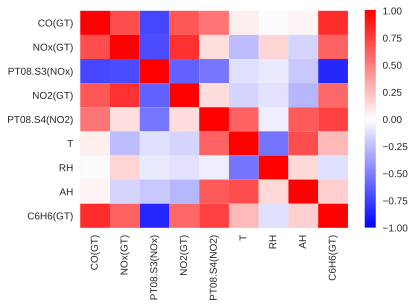

In [ ]:
corr_features = ['CO(GT)',
 'NOx(GT)',
 'PT08.S3(NOx)',
 'NO2(GT)',
 'PT08.S4(NO2)',
 'T',
 'RH',
 'AH',
 'C6H6(GT)']

num_data = new_df.loc[:,corr_features]
corr_matrix = num_data.corr(method='spearman').round(4)
corr_matrix

sns.heatmap(corr_matrix, vmin=-1, vmax=1, cmap='bwr')

**PCA**

In [ ]:

cols = ['PCA' + str(i) for i in range(1,32)]
pca = PCA(n_components=31)
X = new_df.drop(TARGET,axis=1)
X_pca = pca.fit_transform(X)
df_std_pca = pd.DataFrame(X_pca,columns=cols, index=new_df.index)
df_std_pca[TARGET] = new_df[TARGET]

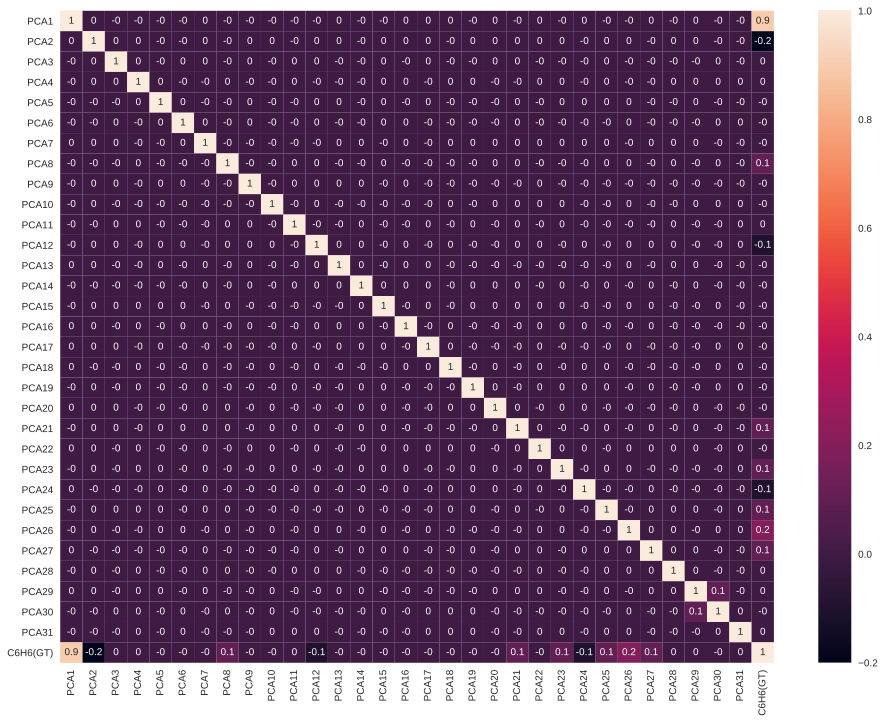

In [ ]:
fig = plt.figure(figsize=(16,12))
ax = fig.add_subplot(111)
sns.heatmap(df_std_pca.corr().round(1),annot=True)

**SPLIT**

In [ ]:
(trainData, 
 testData, 
 train_label, 
 test_label) = train_test_split(df_std_pca.drop(TARGET,
                                            axis=1),
                                            df_std_pca[TARGET],
                                            test_size=0.2,
                                            random_state=42)

print('Size of train set:', trainData.shape)
print('Size of test set:', testData.shape)

print('\nClass distribution on train:',
      train_label.value_counts(normalize=True),
      '\nClass distribution on test:', 
      test_label.value_counts(normalize=True),
      sep='\n')                                

Size of train set: (7192, 31)
Size of test set: (1799, 31)

Class distribution on train:
-1.192094    0.009733
-0.962697    0.009316
-1.102169    0.009177
-0.859096    0.009177
-1.287513    0.009038
               ...   
 2.310787    0.000139
 2.246394    0.000139
 2.451737    0.000139
 2.758657    0.000139
 2.559557    0.000139
Name: C6H6(GT), Length: 391, dtype: float64

Class distribution on test:
-0.113251    0.010561
-1.461170    0.010561
-0.286657    0.010561
-0.910087    0.009450
-0.962697    0.009450
               ...   
 1.816592    0.000556
 1.673184    0.000556
 2.030619    0.000556
 2.162160    0.000556
 1.148956    0.000556
Name: C6H6(GT), Length: 302, dtype: float64


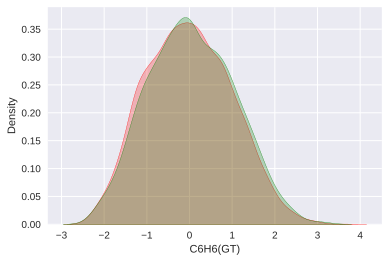

In [ ]:
fig = sns.kdeplot(train_label, shade=True, color="r")
fig = sns.kdeplot(test_label, shade=True, color="g")
plt.show()

**Linear regression**

In [ ]:
# Hyperparameters tuning

params = [
    {
        'n_jobs': [i for i in range(-1, 50, 3)],
        'fit_intercept': [True, False],
        'normalize' : [True, False]
    }
]

rf_model = linear_model.LinearRegression()

cv = KFold(n_splits=5, shuffle=True, random_state=42)
gs = GridSearchCV(rf_model, params, 
                  n_jobs=-1, 
                  scoring=['neg_mean_squared_error', 'r2'], 
                  refit='neg_mean_squared_error', 
                  cv=cv)

In [ ]:
gs.fit(trainData,train_label);

gs.best_params_

{'fit_intercept': True, 'n_jobs': -1, 'normalize': False}

In [ ]:
regressionModel = linear_model.LinearRegression(normalize=False,
                                                fit_intercept=True, n_jobs=-1)
regressionModel.fit(trainData, train_label)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=-1, normalize=False)

In [ ]:
predictedDependentVariables = regressionModel.predict(testData)

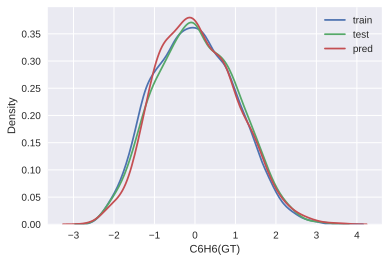

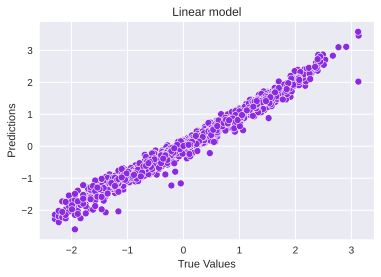

In [ ]:
target_distr_linear(train_label, test_label, predictedDependentVariables)  

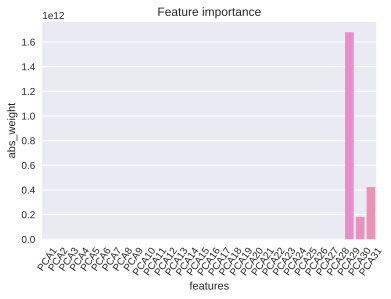

In [ ]:
get_feature_importance(model=regressionModel)

**Detecting heteroscedasticity**

**Graphical Method:**

Firstly do the regression analysis and then plot the error terms against the predicted values. 
If there is a definite pattern (like linear or quadratic or funnel shaped) obtained from the scatter plot then heteroscedasticity is present.


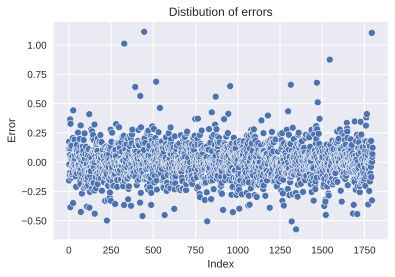

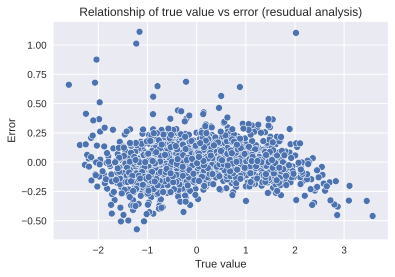

In [ ]:
errors = test_label - predictedDependentVariables 

draw_heteroscedasticity(errors, predictedDependentVariables)

**Conclusion**
* The trend became slightly less pronounced after the use of box-cox transformation.

**Now we will be applying tests.**
A tip is to keep in mind that if we want 95% confidence on our findings and tests then the p-value should be less than 0.05 to be able to reject the null hypothesis.
For these tests the null hypothesis is that all observations have the same error variance, i.e. errors are homoscedastic. The tests differ in which kind of heteroscedasticity is considered as alternative hypothesis. They also vary in the power of the test for different types of heteroscedasticity.

**Goldfeld Quandt Test**  
Checking heteroscedasticity : Using Goldfeld Quandt we test for heteroscedasticity.
* Null Hypothesis: Error terms are homoscedastic
* Alternative Hypothesis: Error terms are heteroscedastic.


In [ ]:
test_goldfeldquandt(errors, testData)

[('F statistic', 0.9651960695345471), ('p-value', 0.699408804032752)]


* the p value has become slightly smaller, but the heteroscedasticity remains.
* Since p value is more than 0.05 in Goldfeld Quandt Test, we can't reject it's null hypothesis that error terms are homoscedastic.


**Metrics**

In [ ]:
print('TRAIN:')
calc_metrics(train_label, regressionModel.predict(trainData), regressionModel,trainData, train_label)
print('\nTEST:')
calc_metrics(test_label, predicted_dv, regressionModel, testData, test_label)


TRAIN:
*** VAL **: 
MSE:   0.02798567825009453
RMSE:  0.16728920542011827
R2:    0.9719997608715211
MAE:   0.11349118950855493
MedAE: 0.08437944766866112
------------------------------
*** Average cross-validation scores ***:
MSE:   0.028568100699328462
RMSE:  0.16876296294692522
R2:    0.9713239062368413
MAE:   0.11444585423436963
MedAE: 0.08541019720830584
------------------------------

TEST:
*** VAL **: 
MSE:   0.023256563911724124
RMSE:  0.15250102921529457
R2:    0.9767184870761763
MAE:   0.11033486526826858
MedAE: 0.08491309186355478
------------------------------
*** Average cross-validation scores ***:
MSE:   0.023405430172126734
RMSE:  0.15272694207658172
R2:    0.9765254890473425
MAE:   0.10919913060197166
MedAE: 0.08438168645518014
------------------------------


**Conclusion**

* The Box-cox transformation slightly affected the data, but it did not completely get rid of heteroskedasticity, it is worth trying to apply other approaches described by me above.
* Metric scores remained high.